In [1]:
import numpy as np
import pandas as pd
import scanpy as sc

In [2]:
sc.settings.set_figure_params(dpi=80)

import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (4,4)

Global seed set to 0


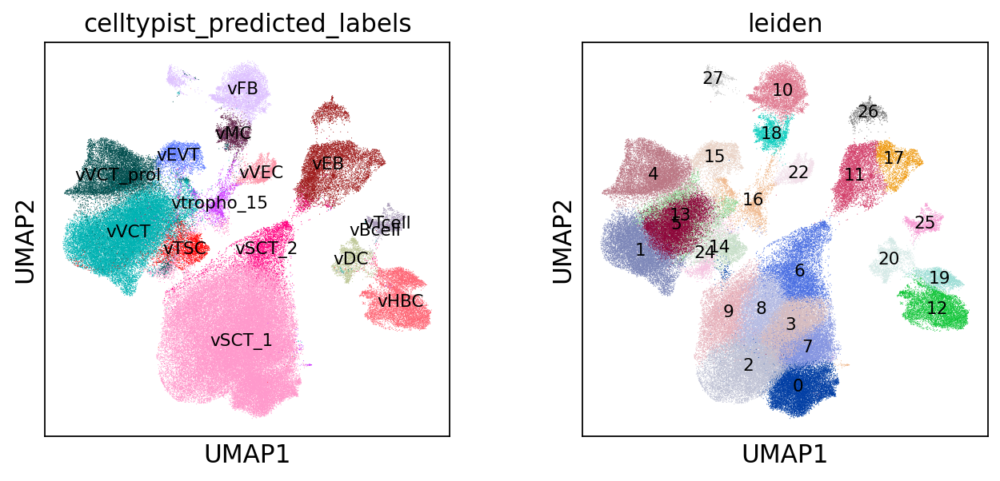

In [3]:
import scvi #Global seed set to 0 to ensure reproducibility. 

#Read the already integrated dataset with LV15: few spurious Leiden clusters are filtered out. 
latest= "/data/analysis/preeclampsia_2019/placenta_atlas_2022/villi_anndata/Placenta_cellbender_LV15_basic.h5ad"

#Read the recently written anndata:
ldata= sc.read_h5ad(latest)


sc.pl.umap(ldata, color=["celltypist_predicted_labels", "leiden"], legend_loc= "on data", 
          legend_fontweight= 'normal', legend_fontsize= 'x-small')

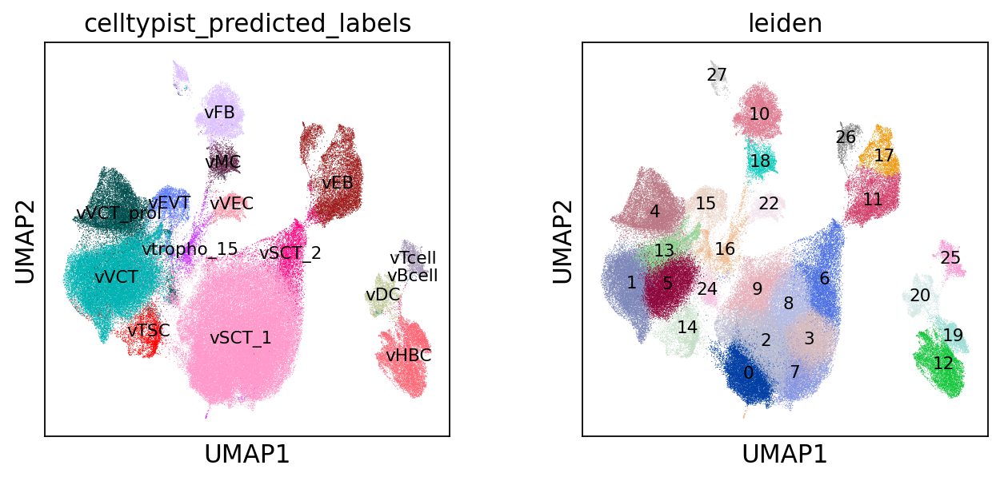

In [4]:
ldata_umap01= ldata.copy()

sc.tl.umap(ldata_umap01, random_state=0, maxiter= 1000) #Next, increase the maxiter=1000. 


#Kindly note that this annotations are not final & things are refined subsequently (also, with help from trajectory)
#Notebook is shared for exploratory data analysis & to show steps involved. 
sc.pl.umap(ldata_umap01, color=["celltypist_predicted_labels", "leiden"], legend_loc= "on data", 
          legend_fontweight= 'normal', legend_fontsize= 'x-small')

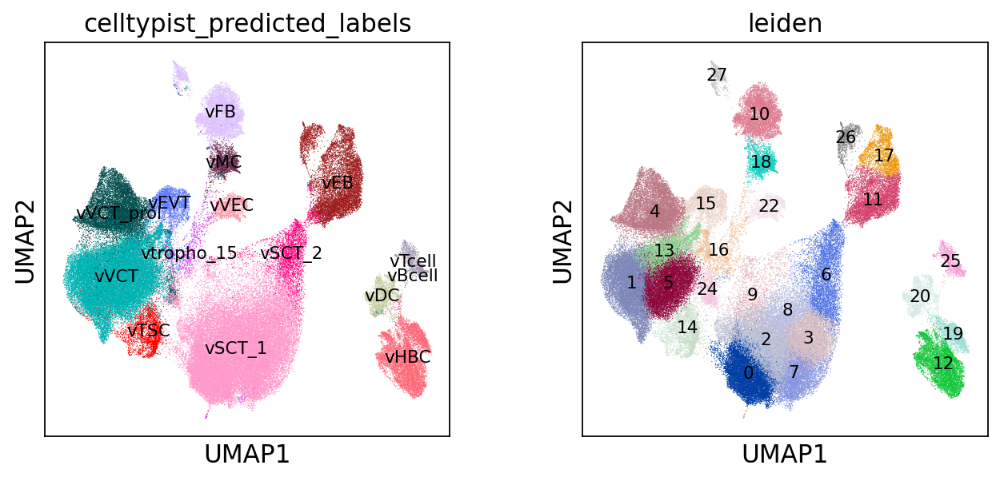

In [5]:
#Subset the control samples (early/late) for further work. 
ldata_control= ldata_umap01[ldata_umap01.obs['disease']== 'C']

sc.pl.umap(ldata_control, color=["celltypist_predicted_labels", "leiden"], legend_loc= "on data", 
          legend_fontweight= 'normal', legend_fontsize= 'x-small')

Trying to set attribute `._uns` of view, copying.


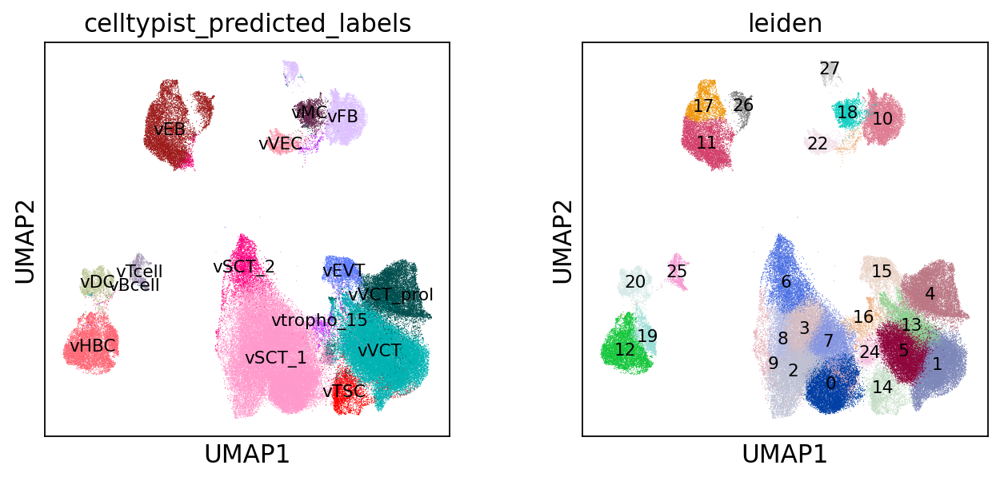

In [7]:
#Recompute UMAP for the controls: 
sc.tl.umap(ldata_control, random_state=0, maxiter= 1000)  

sc.pl.umap(ldata_control, color=["celltypist_predicted_labels", "leiden"], legend_loc= "on data", 
          legend_fontweight= 'normal', legend_fontsize= 'x-small')

early
late_term


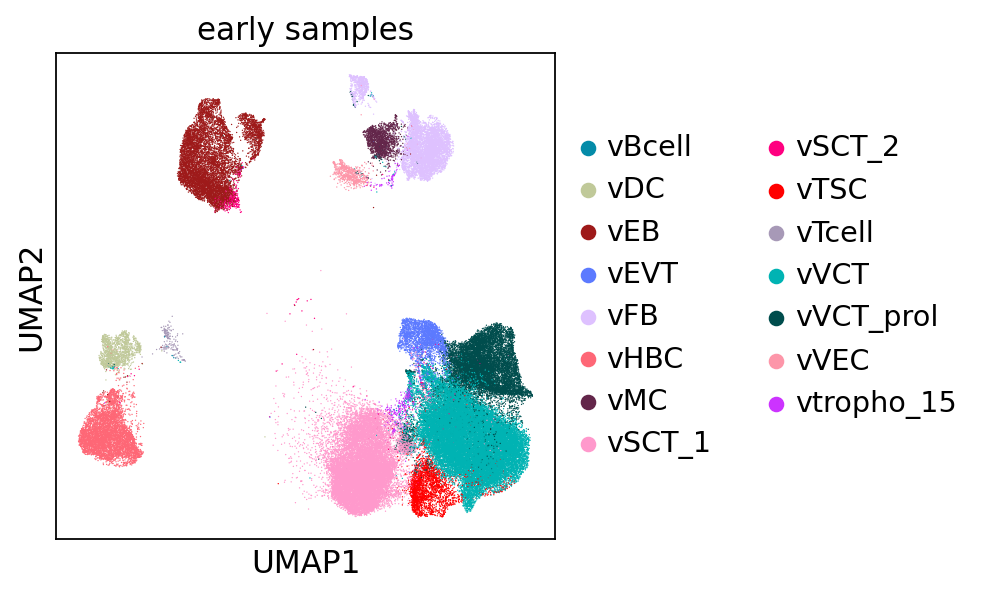

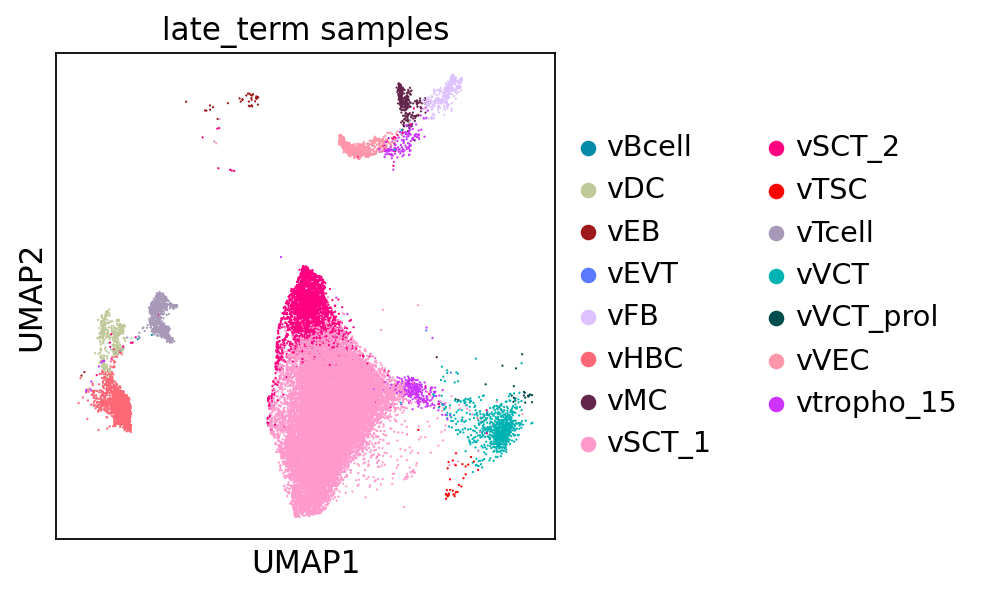

In [8]:
#Split the UMAP by time/disease: 
for i in ldata_control.obs['time'].cat.categories:
    print(i) 
    fig= sc.pl.umap(ldata_control[ldata_control.obs['time'] == i], color = 'celltypist_predicted_labels', return_fig=True, title= i+' samples')
    #pdf.savefig(fig)
    

In [9]:
#Convert back to the raw data: for reintegration & topic modelling. 
#Can be done either on controls or with old PE samples. 
#Need to be repeated: i). either after finalizing control annotation or, ii) all samples (PE included). 
ldata_topic= ldata_control.raw.to_adata()

ldata_topic

AnnData object with n_obs × n_vars = 111787 × 29148
    obs: 'batch', 'cohort', 'disease', 'donor_id', 'gestational_days', 'gestational_weeks', 'library', 'maternal_BMI', 'maternal_age', 'placental_volume', 'procurement', 'smoking', 'time', 'tissue', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_MT_genes', 'log1p_total_counts_MT_genes', 'pct_counts_MT_genes', 'total_counts_Ribo_genes', 'log1p_total_counts_Ribo_genes', 'pct_counts_Ribo_genes', 'total_counts_HB_genes', 'log1p_total_counts_HB_genes', 'pct_counts_HB_genes', 'percent_mt2', 'n_counts', 'percent_Ribo2', 'percent_HB2', 'n_genes', 'XIST-counts', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden', 'celltypist_majority_voting', 'celltypist_predicted_labels'
    var: 'gene_ids-0-0-0', 'gene_ids-1-0-0', 'gene_ids-2-0-0', 'feature_types-2-0-0', 'genome-2-0-0', 'gene_ids-3-0-0', 'feature_types-3-0-0', 'genome-3-0-0',

In [10]:
ldata_topic.layers["counts"] = ldata_topic.X.copy() #preserve counts

sc.pp.normalize_total(ldata_topic, target_sum=10e4)
sc.pp.log1p(ldata_topic)
ldata_topic.raw = ldata_topic #freeze the state in `.raw`

In [14]:
#Recompute HVG for the Latent Dirichlet Allocation (LDA) estimation: 
sc.pp.highly_variable_genes(ldata_control, n_top_genes= 3000, batch_key= "donor_id", subset=True)

/home/debnatho/anaconda3/envs/scvi_analysis/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [15]:
ldata_control.obs['leiden'].cat.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19', '20', '22', '24', '25', '26',
       '27'],
      dtype='object')

Color UMAP by topic proportions:

By coloring by UMAP by topic proportions, we find that the learned topics are generally dominant in cells close together in the UMAP space. In some cases, a topic is dominant in multiple clusters in the UMAP, which indicates similarilty between these clusters despite being far apart in the plot. This is not surprising considering that UMAP does not preserve local relationships beyond a certain threshold.

In [16]:
import collections.abc
import logging
from typing import Optional, Sequence, Union

import numpy as np
import pandas as pd
import pyro
import torch
from anndata import AnnData

from scvi._constants import _CONSTANTS
from scvi.data._anndata import _setup_anndata
from scvi.module import AmortizedLDAPyroModule
from scvi.utils import setup_anndata_dsp

from .base import BaseModelClass, PyroSviTrainMixin

logger = logging.getLogger(__name__)


class AmortizedLDA(PyroSviTrainMixin, BaseModelClass):
    """
    Amortized Latent Dirichlet Allocation [Blei03]_.
    Parameters
    ----------
    adata
        AnnData object that has been registered via :meth:`~scvi.model.AmortizedLDA.setup_anndata`.
    n_topics
        Number of topics to model.
    n_hidden
        Number of nodes in the hidden layer of the encoder.
    cell_topic_prior
        Prior of cell topic distribution. If `None`, defaults to `1 / n_topics`.
    topic_feature_prior
        Prior of topic feature distribution. If `None`, defaults to `1 / n_topics`.
    Examples
    --------
    >>> adata = anndata.read_h5ad(path_to_anndata)
    >>> scvi.model.AmortizedLDA.setup_anndata(adata)
    >>> model = scvi.model.AmortizedLDA(adata)
    >>> model.train()
    >>> feature_by_topic = model.get_feature_by_topic()
    >>> adata.obsm["X_LDA"] = model.get_latent_representation()
    """

    def __init__(
        self,
        adata: AnnData,
        n_topics: int = 20,
        n_hidden: int = 128,
        cell_topic_prior: Optional[Union[float, Sequence[float]]] = None,
        topic_feature_prior: Optional[Union[float, Sequence[float]]] = None,
    ):
        # in case any other model was created before that shares the same parameter names.
        pyro.clear_param_store()

        super().__init__(adata)

        n_input = self.summary_stats["n_vars"]

        if (
            cell_topic_prior is not None
            and not isinstance(cell_topic_prior, float)
            and (
                not isinstance(cell_topic_prior, collections.abc.Sequence)
                or len(cell_topic_prior) != n_topics
            )
        ):
            raise ValueError(
                f"cell_topic_prior, {cell_topic_prior}, must be None, "
                f"a float or a Sequence of length n_topics."
            )
        if (
            topic_feature_prior is not None
            and not isinstance(topic_feature_prior, float)
            and (
                not isinstance(topic_feature_prior, collections.abc.Sequence)
                or len(topic_feature_prior) != n_input
            )
        ):
            raise ValueError(
                f"topic_feature_prior, {topic_feature_prior}, must be None, "
                f"a float or a Sequence of length n_input."
            )

        self.module = AmortizedLDAPyroModule(
            n_input=n_input,
            n_topics=n_topics,
            n_hidden=n_hidden,
            cell_topic_prior=cell_topic_prior,
            topic_feature_prior=topic_feature_prior,
        )

        self.init_params_ = self._get_init_params(locals())

    @staticmethod
    @setup_anndata_dsp.dedent
    def setup_anndata(
        adata: AnnData,
        layer: Optional[str] = None,
        copy: bool = False,
    ) -> Optional[AnnData]:
        """
        %(summary)s.
        Parameters
        ----------
        %(param_adata)s
        %(param_layer)s
        %(param_copy)s
        Returns
        -------
        %(returns)s
        """
        return _setup_anndata(
            adata,
            layer=layer,
            copy=copy,
        )

    def get_feature_by_topic(self, n_samples=5000) -> pd.DataFrame:
        """
        Gets a Monte-Carlo estimate of the expectation of the feature by topic matrix.
        Parameters
        ----------
        adata
            AnnData to transform. If None, returns the feature by topic matrix for
            the source AnnData.
        n_samples
            Number of samples to take for the Monte-Carlo estimate of the mean.
        Returns
        -------
        A `n_var x n_topics` Pandas DataFrame containing the feature by topic matrix.
        """
        self._check_if_trained(warn=False)

        topic_by_feature = self.module.topic_by_feature(n_samples=n_samples)

        return pd.DataFrame(
            data=topic_by_feature.numpy().T,
            index=self.adata.var_names,
            columns=[f"topic_{i}" for i in range(topic_by_feature.shape[0])],
        )

    def get_latent_representation(
        self,
        adata: Optional[AnnData] = None,
        indices: Optional[Sequence[int]] = None,
        batch_size: Optional[int] = None,
        n_samples: int = 5000,
    ) -> pd.DataFrame:
        """
        Converts a count matrix to an inferred topic distribution.
        Parameters
        ----------
        adata
            AnnData object with equivalent structure to initial AnnData. If `None`, defaults to the
            AnnData object used to initialize the model.
        indices
            Indices of cells in adata to use. If `None`, all cells are used.
        batch_size
            Minibatch size for data loading into model. Defaults to `scvi.settings.batch_size`.
        n_samples
            Number of samples to take for the Monte-Carlo estimate of the mean.
        Returns
        -------
        A `n_obs x n_topics` Pandas DataFrame containing the normalized estimate
        of the topic distribution for each observation.
        """
        self._check_if_trained(warn=False)
        adata = self._validate_anndata(adata)

        dl = self._make_data_loader(adata=adata, indices=indices, batch_size=batch_size)

        transformed_xs = []
        for tensors in dl:
            x = tensors[_CONSTANTS.X_KEY]
            transformed_xs.append(
                self.module.get_topic_distribution(x, n_samples=n_samples)
            )
        transformed_x = torch.cat(transformed_xs).numpy()

        return pd.DataFrame(
            data=transformed_x,
            index=adata.obs_names,
            columns=[f"topic_{i}" for i in range(transformed_x.shape[1])],
        )

    def get_elbo(
        self,
        adata: Optional[AnnData] = None,
        indices: Optional[Sequence[int]] = None,
        batch_size: Optional[int] = None,
    ) -> float:
        """
        Return the ELBO for the data.
        The ELBO is a lower bound on the log likelihood of the data used for optimization
        of VAEs. Note, this is not the negative ELBO, higher is better.
        Parameters
        ----------
        adata
            AnnData object with equivalent structure to initial AnnData. If `None`, defaults to the
            AnnData object used to initialize the model.
        indices
            Indices of cells in adata to use. If `None`, all cells are used.
        batch_size
            Minibatch size for data loading into model. Defaults to `scvi.settings.batch_size`.
        Returns
        -------
        The positive ELBO.
        """
        self._check_if_trained(warn=False)
        adata = self._validate_anndata(adata)

        dl = self._make_data_loader(adata=adata, indices=indices, batch_size=batch_size)

        elbos = []
        for tensors in dl:
            x = tensors[_CONSTANTS.X_KEY]
            library = x.sum(dim=1)
            elbos.append(self.module.get_elbo(x, library, len(dl.indices)))
        return np.mean(elbos)

    def get_perplexity(
        self,
        adata: Optional[AnnData] = None,
        indices: Optional[Sequence[int]] = None,
        batch_size: Optional[int] = None,
    ) -> float:
        """
        Computes approximate perplexity for `adata`.
        Perplexity is defined as exp(-1 * log-likelihood per count).
        Parameters
        ----------
        adata
            AnnData object with equivalent structure to initial AnnData. If `None`, defaults to the
            AnnData object used to initialize the model.
        indices
            Indices of cells in adata to use. If `None`, all cells are used.
        batch_size
            Minibatch size for data loading into model. Defaults to `scvi.settings.batch_size`.
        Returns
        -------
        Perplexity.
        """
        self._check_if_trained(warn=False)
        adata = self._validate_anndata(adata)

        dl = self._make_data_loader(adata=adata, indices=indices, batch_size=batch_size)
        total_counts = sum(tensors[_CONSTANTS.X_KEY].sum().item() for tensors in dl)

        return np.exp(
            self.get_elbo(adata=adata, indices=indices, batch_size=batch_size)
            / total_counts
        )

ModuleNotFoundError: No module named 'pyro'

In [20]:
#Number of topics= number of Leiden clusters (to verify which clusters should be merged)
#https://docs.scvi-tools.org/en/0.14.2/api/reference/scvi.model.AmortizedLDA.html
n_topics = 28

#Amortized Latent Dirichlet Allocation: actually, can work directly on ldata_control on raw data slot: "counts"
scvi.model.AmortizedLDA.setup_anndata(ldata_control, layer = "counts")

LDA_model = scvi.model.AmortizedLDA(ldata_control, n_topics = n_topics)

INFO     No batch_key inputted, assuming all cells are same batch                            
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.layers["counts"]                                              
INFO     Successfully registered anndata object containing 111787 cells, 3000 vars, 1        
         batches, 1 labels, and 0 proteins. Also registered 0 extra categorical covariates   
         and 0 extra continuous covariates.                                                  
INFO     Please do not further modify adata until model is trained.                          


By default we train with KL annealing which means the effective loss will generally not decrease steadily in the beginning. Our Pyro implementations present this train loss term as the elbo_train in the progress bar which is misleading. We plan on correcting this in the future.

In [21]:
LDA_model.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
/home/debnatho/anaconda3/envs/scvi_analysis/lib/python3.7/site-packages/pytorch_lightning/trainer/configuration_validator.py:99: UserWarning: you passed in a val_dataloader but have no validation_step. Skipping val loop
  rank_zero_warn(f'you passed in a {loader_name} but have no {step_name}. Skipping {stage} loop')


Epoch 179/179: 100%|██████████| 179/179 [58:04<00:00, 19.47s/it, v_num=1, elbo_train=4.79e+8]


Visualizing learned topics:
    
By calling model.get_latent_representation(), the model will compute a Monte Carlo estimate of the topic proportions for each cell. Since we use a logistic-Normal distribution to approximate the Dirichlet distribution, the model cannot compute the analytic mean. The number of samples used to compute the latent representation can be configured with the optional argument n_samples

In [22]:
topic_prop = LDA_model.get_latent_representation()
topic_prop.head()

,topic_0,topic_1,topic_2,topic_3,topic_4,topic_5,topic_6,topic_7,topic_8,topic_9,...,topic_18,topic_19,topic_20,topic_21,topic_22,topic_23,topic_24,topic_25,topic_26,topic_27
CTTCAATTCTGGTCAA-1-0-0-0,8.025228e-04,4.133728e-02,0.006731,9.557250e-06,1.196479e-05,8.969414e-05,7.108218e-07,1.051981e-03,3.050600e-02,0.559130,...,2.599820e-03,1.146598e-04,4.314130e-07,7.838493e-04,2.183972e-02,8.309234e-04,3.987921e-03,6.291227e-02,0.142040,8.252623e-02
AGTCATGGTAACACCT-1-0-0-0,1.744288e-08,6.904428e-11,0.000012,7.820257e-11,3.292358e-12,5.120359e-10,1.005291e-11,4.087181e-07,2.284524e-09,0.999901,...,2.653769e-08,1.751953e-09,4.023176e-11,2.810765e-07,3.652849e-08,7.099483e-07,4.640975e-05,6.331748e-09,0.000023,4.277460e-07
CTCCTCCGTTTCACTT-1-0-0-0,1.278852e-03,3.858247e-02,0.012105,1.173688e-06,1.866274e-06,1.366009e-06,3.689425e-05,7.516933e-03,3.017649e-01,0.000016,...,2.994082e-07,5.367323e-05,5.334863e-06,1.673824e-07,6.321474e-01,8.545607e-06,5.692626e-06,1.523751e-06,0.000135,9.012623e-04
CCGCAAGTCTATACTC-1-0-0-0,4.130046e-06,2.083329e-04,0.000248,1.821986e-06,5.535354e-07,2.223229e-07,1.334739e-06,1.092585e-05,8.943219e-03,0.000006,...,1.979699e-07,9.443424e-07,3.374349e-07,1.283227e-08,9.835919e-01,1.834097e-08,9.389012e-07,8.165925e-06,0.000009,1.423015e-03
CTCCACACACCAACAT-1-0-0-0,8.958983e-05,1.233598e-02,0.016204,3.992832e-06,2.237677e-06,7.572636e-06,2.439544e-04,4.305483e-03,4.422749e-01,0.273442,...,5.683395e-06,5.568362e-05,7.523995e-05,7.739379e-06,4.817675e-02,1.290645e-05,5.977926e-05,3.128121e-03,0.005706,1.110069e-02


In [23]:
#Save topic proportions in obsm and obs columns.
ldata_control.obsm["X_LDA"] = topic_prop

for i in range(n_topics):
  ldata_control.obs[f"LDA_topic_{i}"] = topic_prop[[f"topic_{i}"]]

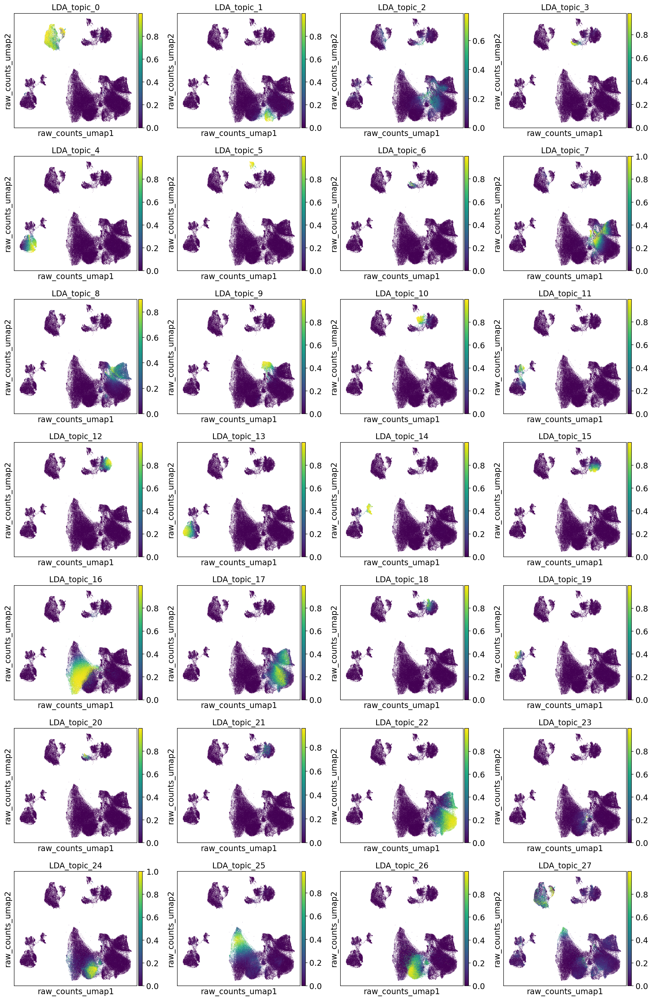

In [24]:
#Save UMAP to custom .obsm field.
ldata_control.obsm["raw_counts_umap"] = ldata_control.obsm["X_umap"].copy()

sc.pl.embedding(ldata_control, "raw_counts_umap", color = [f"LDA_topic_{i}" for i in range(n_topics)])

Find top genes per topic:

Similar to the topic proportions, model.get_feature_by_topic() returns a Monte Carlo estimate of the gene by topic matrix, which contains the proportion that a gene is weighted in each topic. This is also due to another approximation of the Dirichlet with a logistic-Normal distribution. We can inspect each topic in this matrix and sort by proportion allocated to each gene to determine top genes characterizing each topic.

In [26]:
#Features per Leiden topic: 
feature_by_topic = LDA_model.get_feature_by_topic()

feature_by_topic.head()

,topic_0,topic_1,topic_2,topic_3,topic_4,topic_5,topic_6,topic_7,topic_8,topic_9,...,topic_18,topic_19,topic_20,topic_21,topic_22,topic_23,topic_24,topic_25,topic_26,topic_27
ISG15,1.442528e-05,2.138152e-06,1.299115e-04,0.000149,1.418207e-05,1.321462e-05,5.462382e-05,5.328024e-05,3.776491e-05,2.752322e-04,...,2.168947e-05,1.952490e-05,5.878237e-05,7.872291e-05,3.116683e-07,3.098624e-07,2.477324e-08,4.975438e-06,2.073887e-08,1.093653e-06
AGRN,8.830212e-05,1.089448e-07,3.761758e-05,0.000095,9.081590e-06,2.840966e-05,6.571071e-05,1.058503e-05,3.719731e-05,6.651601e-05,...,1.932121e-05,3.058298e-05,3.216591e-05,7.484502e-05,3.244404e-06,8.961907e-07,2.218839e-08,9.155685e-08,1.866893e-08,1.022187e-05
TNFRSF18,1.571359e-07,7.531070e-08,3.284793e-06,0.000006,4.687491e-08,1.629995e-06,4.395305e-07,1.365272e-07,6.348233e-08,6.384331e-07,...,1.040119e-07,3.533852e-07,4.470111e-07,1.719659e-07,1.570751e-08,6.154651e-07,2.415976e-08,3.783379e-07,4.451696e-08,1.144129e-07
TNFRSF4,3.945030e-06,1.615480e-07,1.646121e-07,0.000187,3.954054e-06,1.001084e-07,4.871959e-05,4.749866e-08,5.866783e-08,5.663558e-07,...,3.197506e-07,7.999689e-07,3.580917e-05,1.864552e-07,1.516148e-08,3.141024e-07,3.610972e-07,2.169244e-06,5.686980e-07,1.159683e-06
CPTP,1.134371e-05,3.971284e-06,9.914417e-05,0.000091,6.053206e-06,1.409581e-06,2.722587e-06,2.295542e-05,1.214621e-05,9.543570e-06,...,3.173400e-06,3.033120e-06,2.623648e-06,4.809906e-05,1.091401e-05,2.575685e-05,2.711765e-06,1.718674e-05,1.417690e-06,1.324131e-07


In [27]:
rank_by_topic = pd.DataFrame()

for i in range(n_topics):
    topic_name = f"topic_{i}"
    topic = feature_by_topic[topic_name].sort_values(ascending=False)
    rank_by_topic[topic_name] = topic.index
    rank_by_topic[f"{topic_name}_prop"] = topic.values

In [28]:
rank_by_topic.head()

,topic_0,topic_0_prop,topic_1,topic_1_prop,topic_2,topic_2_prop,topic_3,topic_3_prop,topic_4,topic_4_prop,...,topic_23,topic_23_prop,topic_24,topic_24_prop,topic_25,topic_25_prop,topic_26,topic_26_prop,topic_27,topic_27_prop
0,MALAT1,0.227827,MALAT1,0.265127,MALAT1,0.107441,MALAT1,0.232926,MALAT1,0.142846,...,CGA,0.300844,PAPPA2,0.191132,MALAT1,0.520248,MALAT1,0.160446,MALAT1,0.931187
1,TSPAN5,0.027249,CYP19A1,0.094643,MT-CO1,0.034769,PDE4D,0.017205,RBPJ,0.077942,...,KISS1,0.148524,MALAT1,0.126728,PDE4D,0.024032,ADAM12,0.094191,SLC25A37,0.002271
2,RGS6,0.024669,RHOBTB1,0.046279,MT-CO3,0.024918,ZBTB20,0.016492,F13A1,0.061900,...,GDF15,0.049142,ADAM12,0.124500,CSH1,0.020005,PAPPA2,0.051440,EPB41,0.001433
3,SLC25A37,0.021929,TACC2,0.037572,MT-CO2,0.017051,LDB2,0.015731,SLC9A9,0.033930,...,MALAT1,0.033619,CYP19A1,0.042264,CYP19A1,0.016850,CYP19A1,0.036382,ANK1,0.001228
4,ANK1,0.021707,CGA,0.026945,EEF1A1,0.013756,EGFL7,0.012958,CD36,0.024186,...,PLAC4,0.019996,PLAC4,0.022718,ADAM12,0.013230,PLAC4,0.031635,MARCH3,0.001211


In [29]:
rank_by_topic.to_csv('Placenta_control_clusters_topic_leiden_LDA_010222.csv')

In [30]:
ldata_control.obs['celltypist_predicted_labels'].cat.categories

Index(['vBcell', 'vDC', 'vEB', 'vEVT', 'vFB', 'vHBC', 'vMC', 'vSCT_1',
       'vSCT_2', 'vTSC', 'vTcell', 'vVCT', 'vVCT_prol', 'vVEC', 'vtropho_15'],
      dtype='object')

In [31]:
#Number of topics= number of cell types (clusters) (to verify which clusters should be merged)
#https://docs.scvi-tools.org/en/0.14.2/api/reference/scvi.model.AmortizedLDA.html
n_topics = 15

#Amortized Latent Dirichlet Allocation: actually, can work directly on ldata_control on raw data slot: "counts"
scvi.model.AmortizedLDA.setup_anndata(ldata_control, layer = "counts")

LDA_model_celltype = scvi.model.AmortizedLDA(ldata_control, n_topics = n_topics)

INFO     No batch_key inputted, assuming all cells are same batch                            
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.layers["counts"]                                              
INFO     Successfully registered anndata object containing 111787 cells, 3000 vars, 1        
         batches, 1 labels, and 0 proteins. Also registered 0 extra categorical covariates   
         and 0 extra continuous covariates.                                                  
INFO     Please do not further modify adata until model is trained.                          


In [32]:
LDA_model_celltype.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
/home/debnatho/anaconda3/envs/scvi_analysis/lib/python3.7/site-packages/pytorch_lightning/trainer/configuration_validator.py:99: UserWarning: you passed in a val_dataloader but have no validation_step. Skipping val loop
  rank_zero_warn(f'you passed in a {loader_name} but have no {step_name}. Skipping {stage} loop')


Epoch 179/179: 100%|██████████| 179/179 [1:29:52<00:00, 30.12s/it, v_num=1, elbo_train=4.81e+8]


In [33]:
topic_prop_clust = LDA_model_celltype.get_latent_representation()

topic_prop_clust.head()

,topic_0,topic_1,topic_2,topic_3,topic_4,topic_5,topic_6,topic_7,topic_8,topic_9,topic_10,topic_11,topic_12,topic_13,topic_14
CTTCAATTCTGGTCAA-1-0-0-0,2.999356e-04,0.004086,0.018018,1.269897e-04,0.005784,0.173163,0.145442,4.602476e-03,1.705391e-01,0.003320,0.027103,0.410860,1.685767e-03,1.914412e-02,1.582333e-02
AGTCATGGTAACACCT-1-0-0-0,2.234504e-07,0.000050,0.000260,2.001828e-08,0.000003,0.000009,0.000005,1.527734e-07,3.859052e-09,0.000004,0.000362,0.999308,9.733866e-08,3.111590e-07,4.178162e-08
CTCCTCCGTTTCACTT-1-0-0-0,4.202001e-04,0.022685,0.000025,1.149566e-04,0.000067,0.000734,0.000054,2.237981e-05,8.598417e-01,0.000024,0.000152,0.018137,3.439386e-05,4.332512e-02,5.436391e-02
CCGCAAGTCTATACTC-1-0-0-0,3.334606e-05,0.000012,0.000018,4.940187e-06,0.000026,0.000228,0.010482,1.091169e-05,9.881690e-01,0.000012,0.000001,0.000086,2.384187e-06,9.113275e-04,1.303724e-06
CTCCACACACCAACAT-1-0-0-0,3.501786e-04,0.001448,0.000765,3.895087e-05,0.000069,0.004926,0.010792,1.367833e-04,4.705950e-01,0.000088,0.000160,0.432157,9.673455e-05,1.221145e-02,6.616476e-02


In [34]:
#Save topic proportions in obsm and obs columns.
ldata_control.obsm["X_LDA"] = topic_prop_clust

for i in range(n_topics):
  ldata_control.obs[f"LDA_topic_{i}"] = topic_prop_clust[[f"topic_{i}"]]

In [35]:
#Save UMAP to custom .obsm field.
ldata_control.obsm["raw_counts_umap"] = ldata_control.obsm["X_umap"].copy()

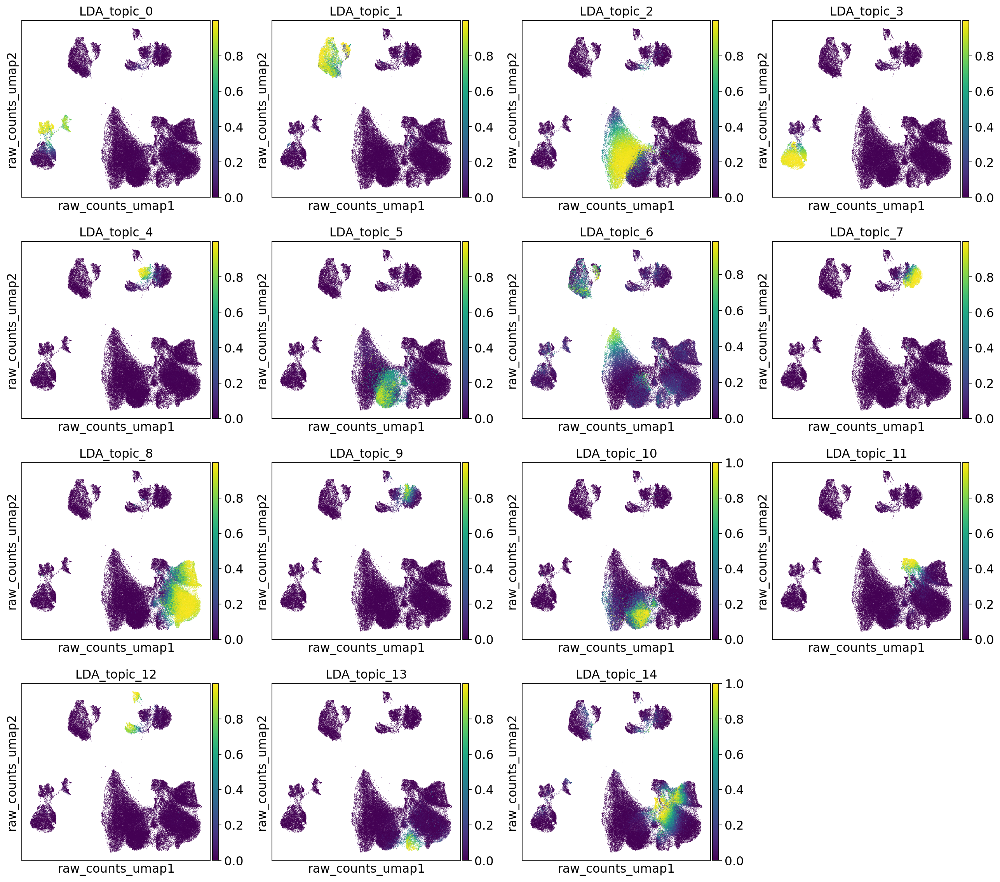

In [36]:
sc.pl.embedding(ldata_control, "raw_counts_umap", color = [f"LDA_topic_{i}" for i in range(n_topics)])

In [37]:
#Features per Leiden topic: 
feature_by_topic = LDA_model_celltype.get_feature_by_topic()

feature_by_topic.head()

,topic_0,topic_1,topic_2,topic_3,topic_4,topic_5,topic_6,topic_7,topic_8,topic_9,topic_10,topic_11,topic_12,topic_13,topic_14
ISG15,0.000104,1.529226e-05,6.015265e-06,1.300050e-05,2.751933e-05,7.122800e-08,1.218496e-06,1.209876e-05,6.851660e-07,3.803075e-05,3.454511e-08,2.664505e-04,0.000032,2.404705e-06,6.397069e-05
AGRN,0.000031,9.090452e-05,8.702208e-07,7.446879e-06,5.089624e-05,5.103247e-08,4.714284e-06,2.944920e-05,1.018617e-05,3.506709e-05,3.468186e-08,6.848542e-05,0.000038,1.703667e-07,2.211546e-05
TNFRSF18,0.000031,2.323985e-07,5.983179e-08,3.586317e-08,9.175393e-08,2.666490e-07,2.599672e-07,9.264967e-08,1.857780e-08,1.248293e-07,3.657755e-08,1.219212e-06,0.000001,1.133870e-07,2.647813e-07
TNFRSF4,0.000042,3.974927e-06,2.200460e-06,1.678366e-06,2.926441e-07,4.522427e-07,1.939658e-06,3.221305e-08,1.976497e-08,1.545667e-07,5.060655e-07,5.299934e-07,0.000030,1.702027e-07,6.691543e-08
CPTP,0.000006,1.181045e-05,1.869930e-05,6.403937e-06,5.868142e-06,3.526766e-06,2.692823e-06,1.163861e-05,1.379009e-05,1.251298e-05,2.702260e-06,1.096372e-05,0.000008,4.617981e-06,4.064408e-05


In [38]:
rank_by_topic = pd.DataFrame()
for i in range(n_topics):
    topic_name = f"topic_{i}"
    topic = feature_by_topic[topic_name].sort_values(ascending=False)
    rank_by_topic[topic_name] = topic.index
    rank_by_topic[f"{topic_name}_prop"] = topic.values
    
rank_by_topic.head()

,topic_0,topic_0_prop,topic_1,topic_1_prop,topic_2,topic_2_prop,topic_3,topic_3_prop,topic_4,topic_4_prop,...,topic_10,topic_10_prop,topic_11,topic_11_prop,topic_12,topic_12_prop,topic_13,topic_13_prop,topic_14,topic_14_prop
0,MALAT1,0.200323,MALAT1,0.232176,MALAT1,0.172532,MALAT1,0.177644,MALAT1,0.122889,...,PAPPA2,0.174534,MALAT1,0.184742,MALAT1,0.175620,MALAT1,0.261820,MALAT1,0.062622
1,PLXDC2,0.027521,TSPAN5,0.027054,ADAM12,0.071204,RBPJ,0.061567,PLCB1,0.029520,...,MALAT1,0.127535,ADAM12,0.044348,CNTN5,0.019073,CYP19A1,0.092861,TENM3,0.026390
2,SLC8A1,0.016765,RGS6,0.024901,PAPPA,0.063327,F13A1,0.044266,LAMA2,0.026500,...,ADAM12,0.125991,TCF7L2,0.043486,CHSY3,0.018598,RHOBTB1,0.045675,ARL15,0.014756
3,ZEB2,0.015645,SLC25A37,0.022682,CSH1,0.061102,SLC9A9,0.030549,PRKG1,0.020402,...,CYP19A1,0.043585,TENM3,0.037551,MEG8,0.018383,TACC2,0.036488,PEG10,0.013059
4,LRMDA,0.014811,ANK1,0.021535,CYP19A1,0.052951,SPP1,0.026398,PLCL1,0.016755,...,PLAC4,0.022466,FN1,0.033053,LSAMP,0.015796,CGA,0.030538,EEF1A1,0.013033


In [39]:
rank_by_topic.to_csv('Placenta_control_topic_celltypist_LDA_010222.csv')

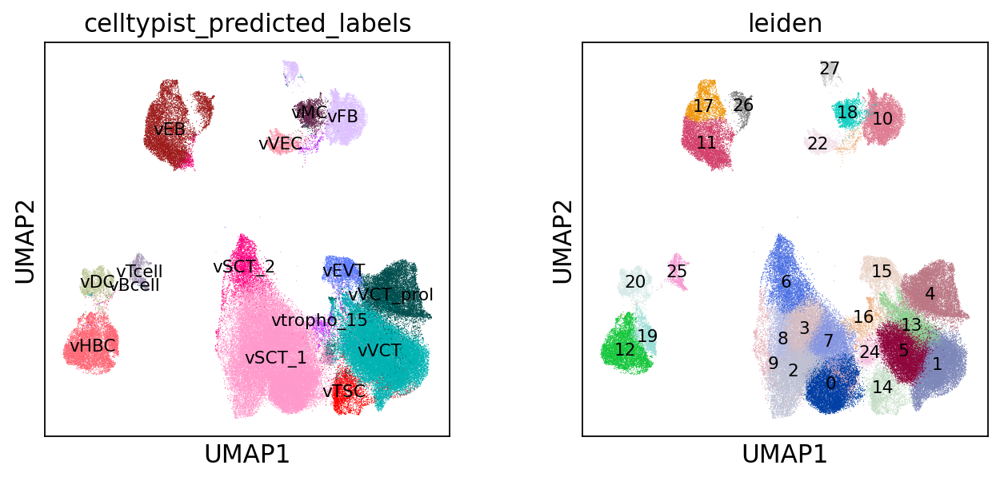

In [40]:
sc.pl.umap(ldata_control, color=["celltypist_predicted_labels", "leiden"], legend_loc= "on data", 
          legend_fontweight= 'normal', legend_fontsize= 'x-small')

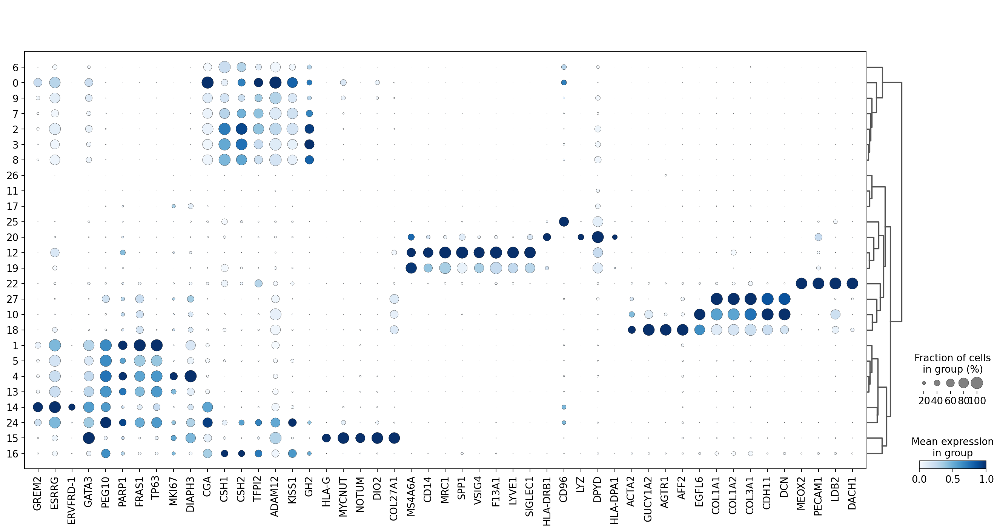

In [119]:
#Markers added later below the UMAP: mainly to chacaterize L24. 
sc.tl.dendrogram(ldata_control, groupby= 'leiden')

#Check for CSH1, CSH2 & TFPI2 in Leiden-16 & 24: L24 is also SCTjuv!! 
#L24 also expresses mild GREM2/ESSRG. The locations of this b/w CTBpf (former APAhi) & STB (SCTs)
#are verified with the final pseudotime analysis. 
sc.pl.dotplot(ldata_control, cell_markers, groupby='leiden', color_map="Blues", use_raw=True, standard_scale="var",
             dendrogram=True)

10X v2
10X v3


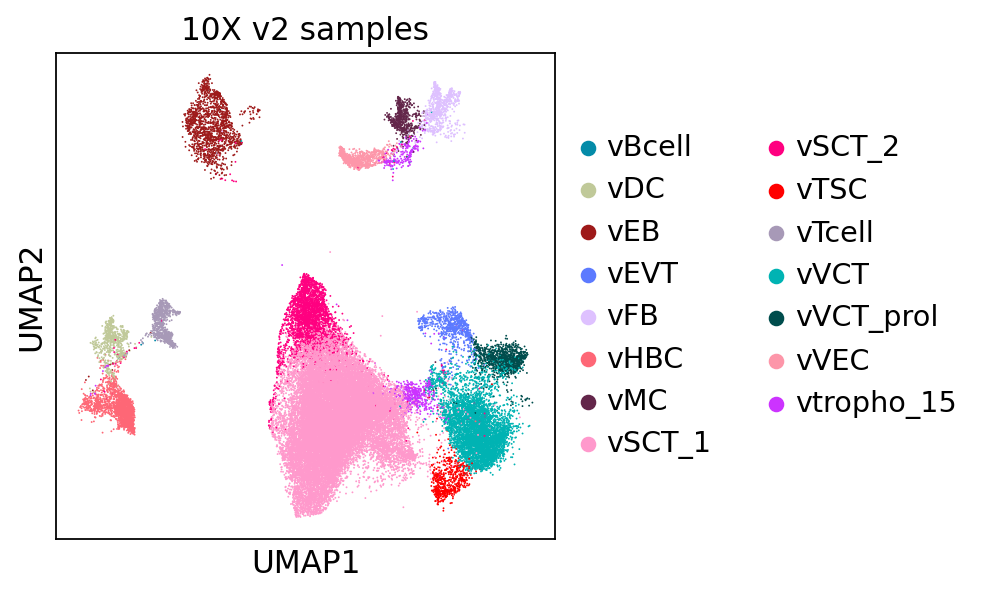

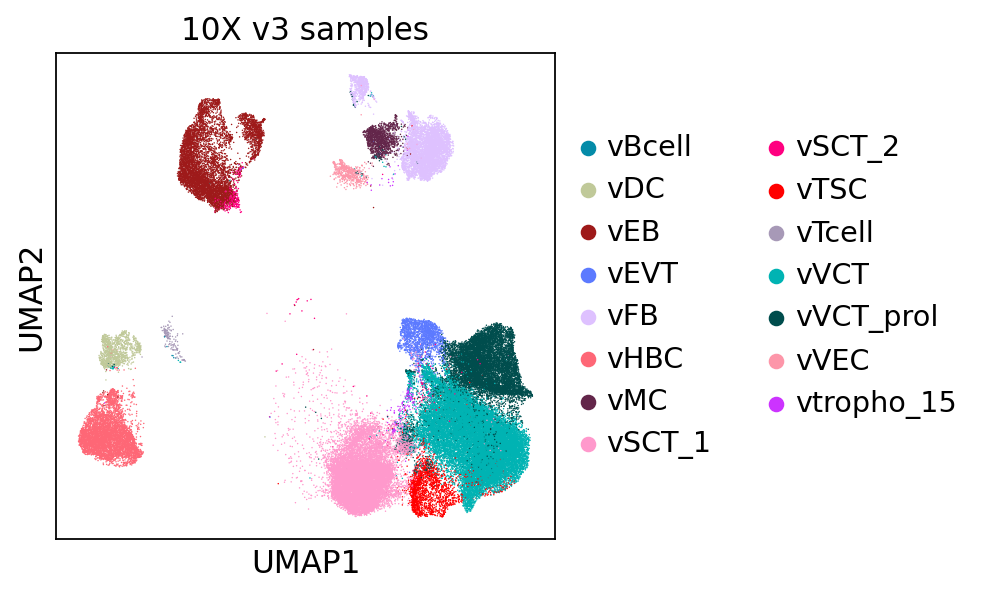

In [46]:
#Separate by library: 
for i in ldata_control.obs['library'].cat.categories:
    print(i) 
    fig= sc.pl.umap(ldata_control[ldata_control.obs['library'] == i], color = 'celltypist_predicted_labels', return_fig=True, title= i+' samples')
    #pdf.savefig(fig)

In [50]:
ldata_control.obs['gestational_weeks'].value_counts()

9     18219
10    15755
8     14259
38    13979
5     12603
6     12376
40    10175
7      8832
39     5589
Name: gestational_weeks, dtype: int64

In [55]:
#Rename the gestational_weeks: https://github.com/theislab/scanpy/issues/925
#https://github.com/theislab/scanpy/issues/1030 
ldata_control.obs['gestational_weeks_new']= ldata_control.obs["gestational_weeks"].map(lambda x: {"9": "9th week", "10": "10th week",
    "8": "8th week", "38": "38th week", "5": "5th week", "6": "6th week", "40": "40th week", "39": "39th week", 
    "7": "7th week"}.get(x, x)).astype("category")

ldata_control.obs['gestational_weeks_new'].value_counts()

9     18219
10    15755
8     14259
38    13979
5     12603
6     12376
40    10175
7      8832
39     5589
Name: gestational_weeks_new, dtype: int64

In [56]:
ldata_control.obs['gestational_weeks_new'].cat.categories

Int64Index([5, 6, 7, 8, 9, 10, 38, 39, 40], dtype='int64')

In [64]:
ldata_control.obs['gestational_weeks_new'] = ldata_control.obs['gestational_weeks_new'].astype('category')

ldata_control.obs['gestational_weeks_new']

CTTCAATTCTGGTCAA-1-0-0-0    10
AGTCATGGTAACACCT-1-0-0-0    10
CTCCTCCGTTTCACTT-1-0-0-0    10
CCGCAAGTCTATACTC-1-0-0-0    10
CTCCACACACCAACAT-1-0-0-0    10
                            ..
CGGGTCATCATGCTCC-1-5-1-0    40
GATCGATGTCGCTTTC-1-5-1-0    40
GACCTGGGTGGCGAAT-1-5-1-0    40
GGAACTTTCAAACCAC-1-5-1-0    40
TTCGAAGGTGGTTTCA-1-5-1-0    40
Name: gestational_weeks_new, Length: 111787, dtype: category
Categories (9, object): ['10', '38', '39', '40', ..., '6', '7', '8', '9']

10
38
39
40
5
6
7
8
9


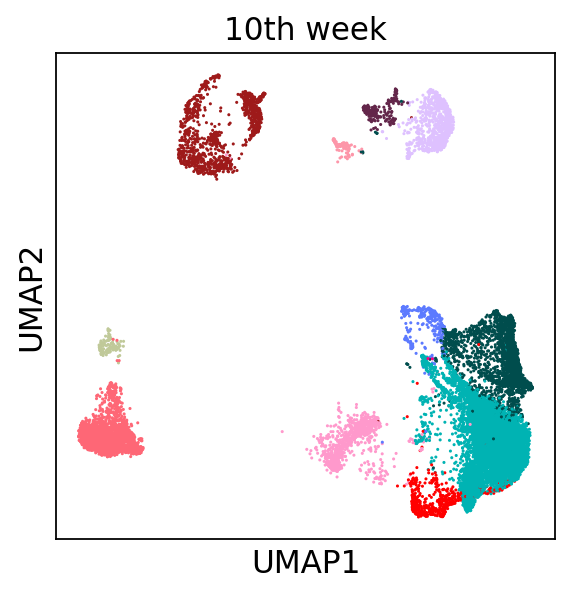

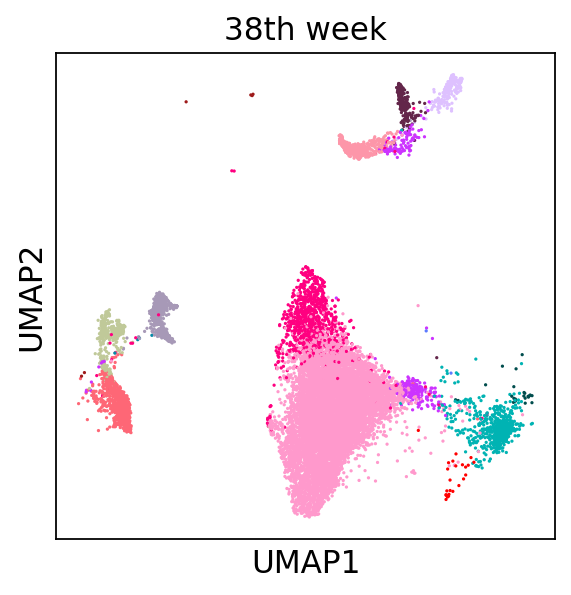

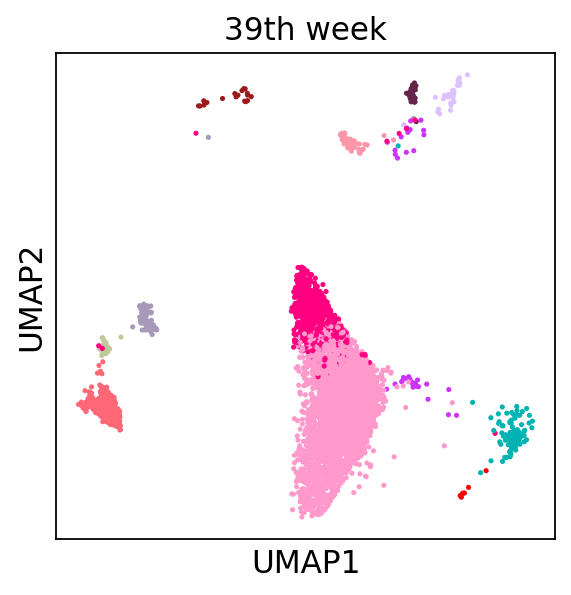

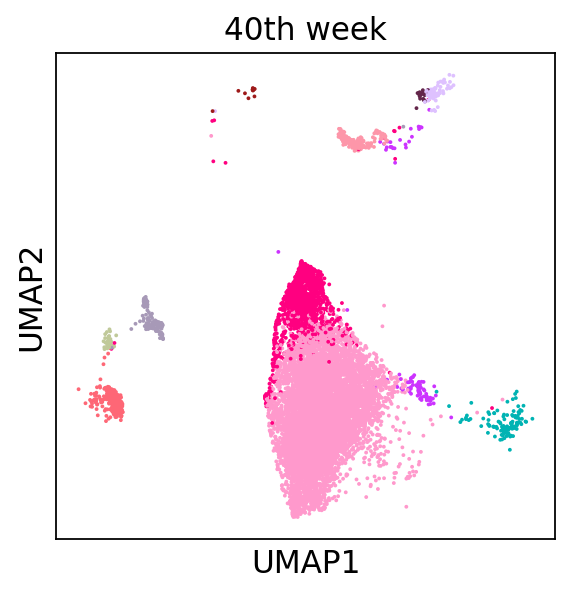

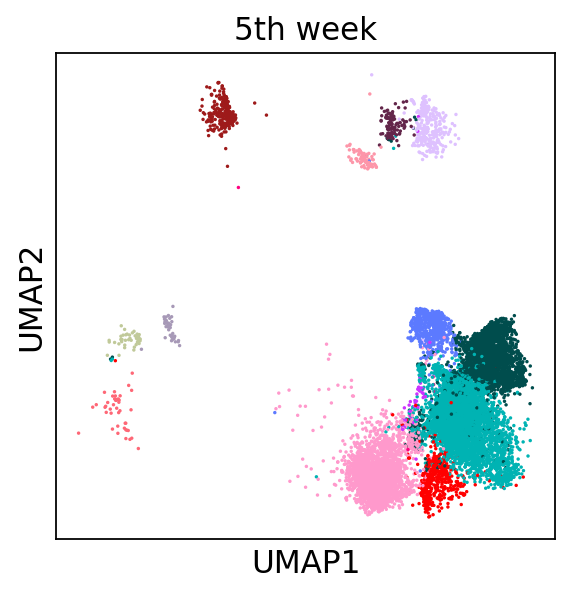

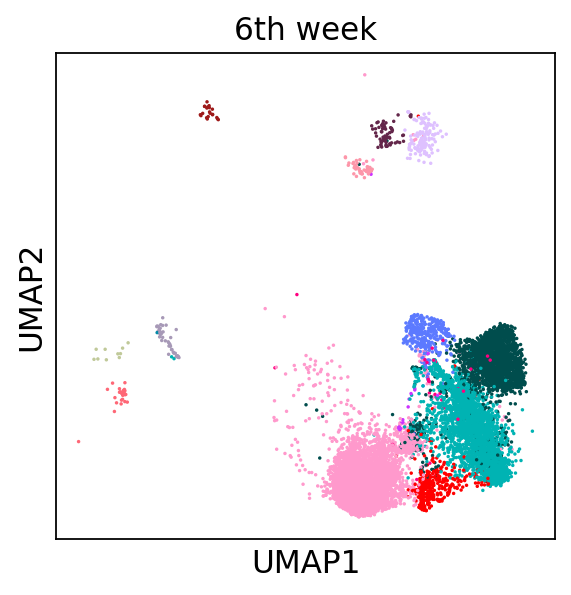

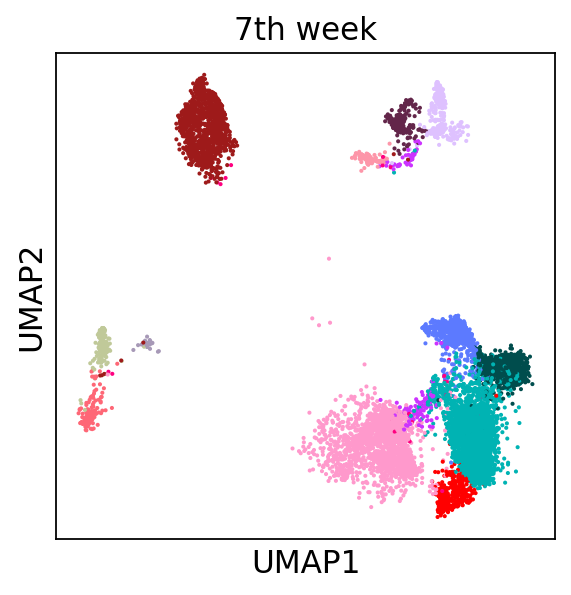

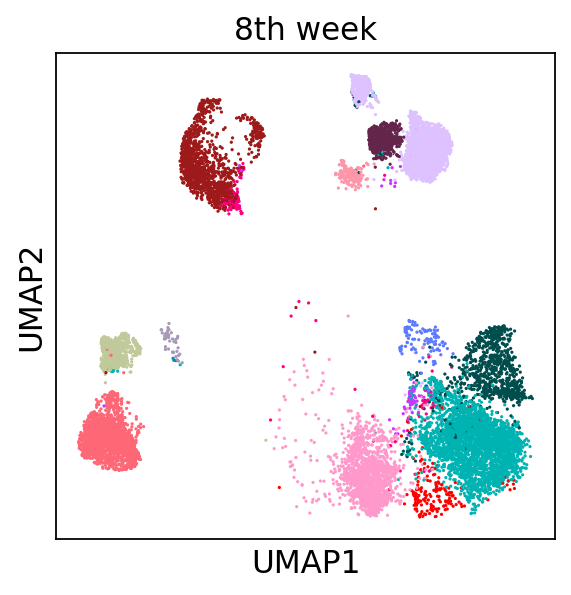

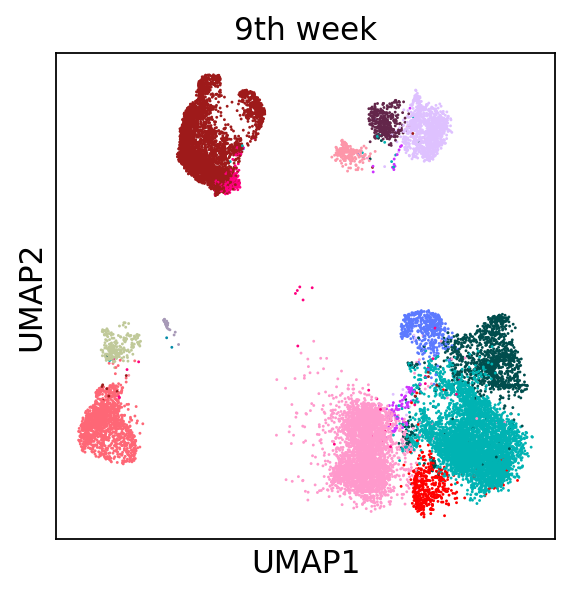

In [68]:
for i in ldata_control.obs['gestational_weeks_new'].cat.categories:
    print(i) 
    fig= sc.pl.umap(ldata_control[ldata_control.obs['gestational_weeks_new'] == i], color = 'celltypist_predicted_labels', legend_loc= {}, 
                    return_fig=True, 
                    title= i+'th week')
    #pdf.savefig(fig)

Donor11
Donor12
Donor34
Donor37
Donor38
Donor39
Donor41
Donor-327-villi
Donor-328-villi
Donor-372-villi
Donor-17025-villi
Donor-SEKR2-villi
Donor-SOZE1-villi
Donor-Term01
Donor-Term02
Donor-Term03


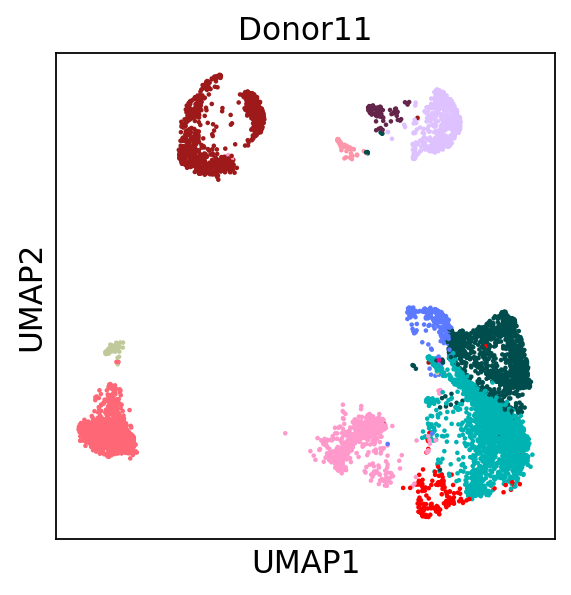

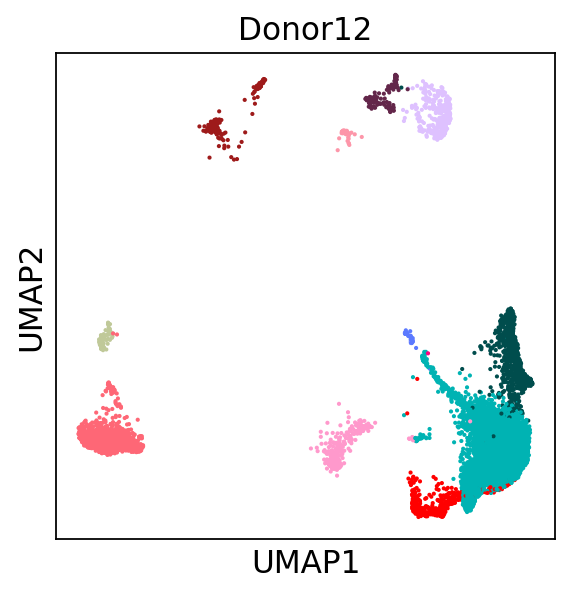

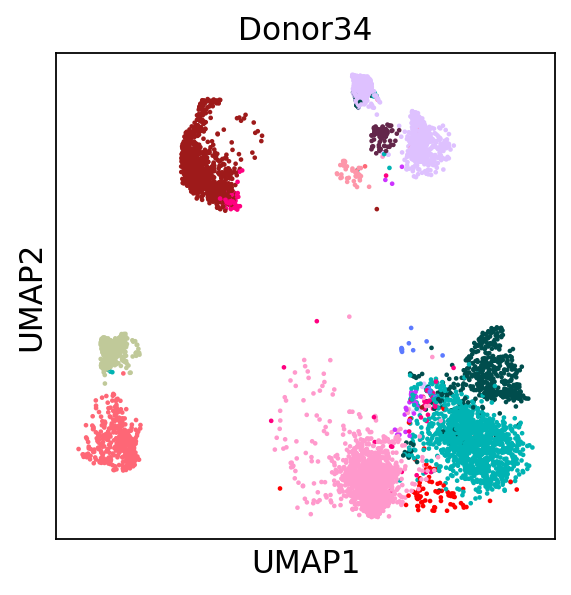

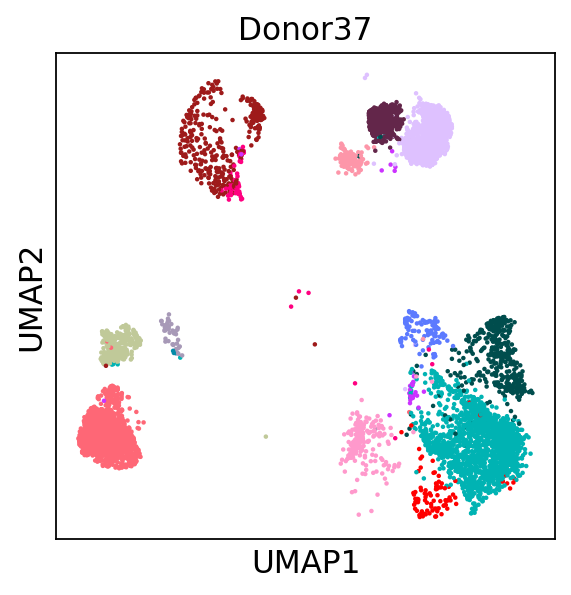

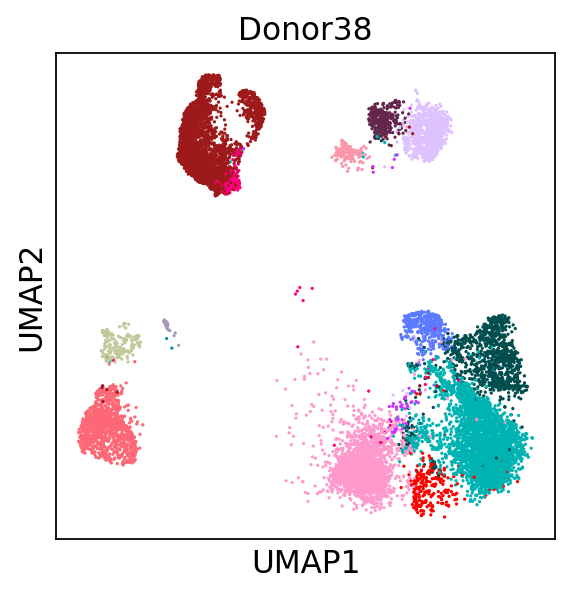

...

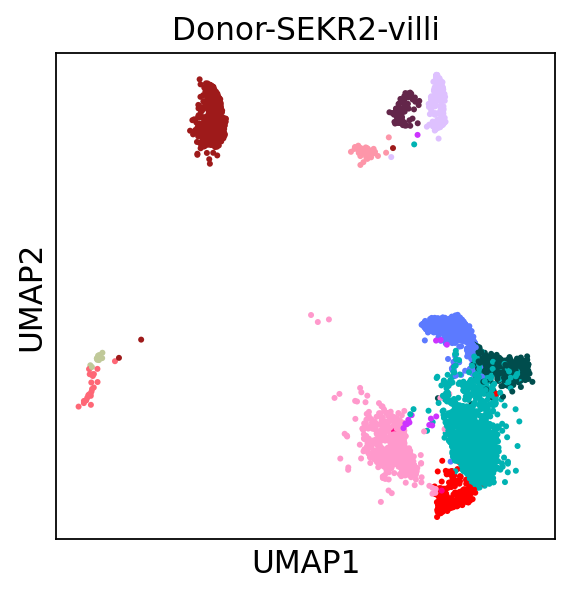

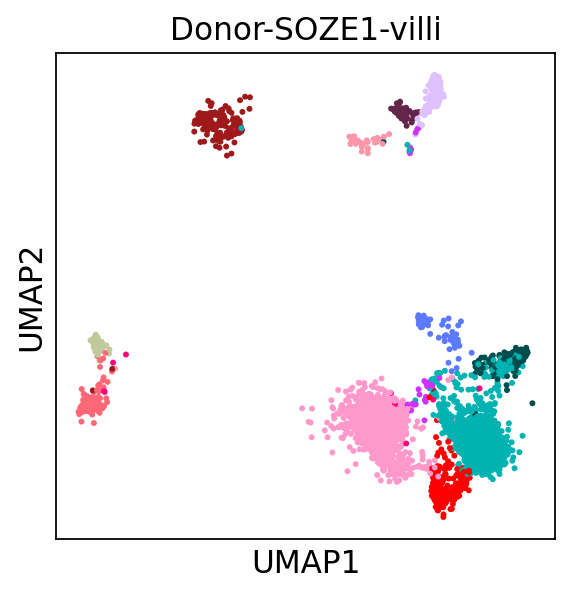

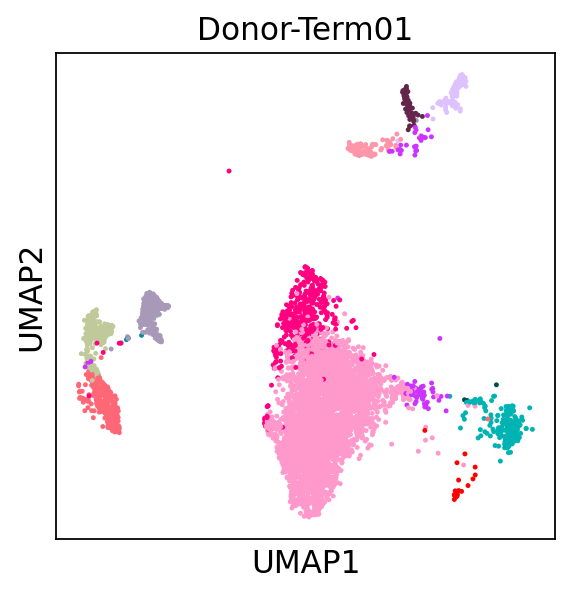

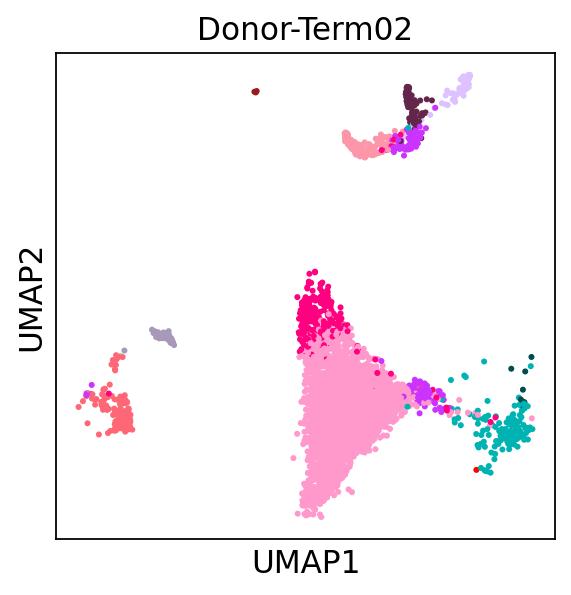

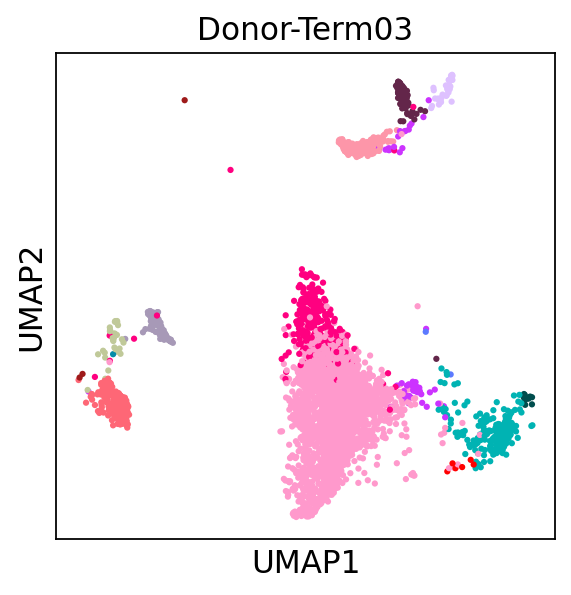

In [71]:
for i in ldata_control.obs['donor_id'].cat.categories:
    print(i) 
    fig= sc.pl.umap(ldata_control[ldata_control.obs['donor_id'] == i], color = 'celltypist_predicted_labels', legend_loc= {}, 
                    return_fig=True, 
                    title= i)

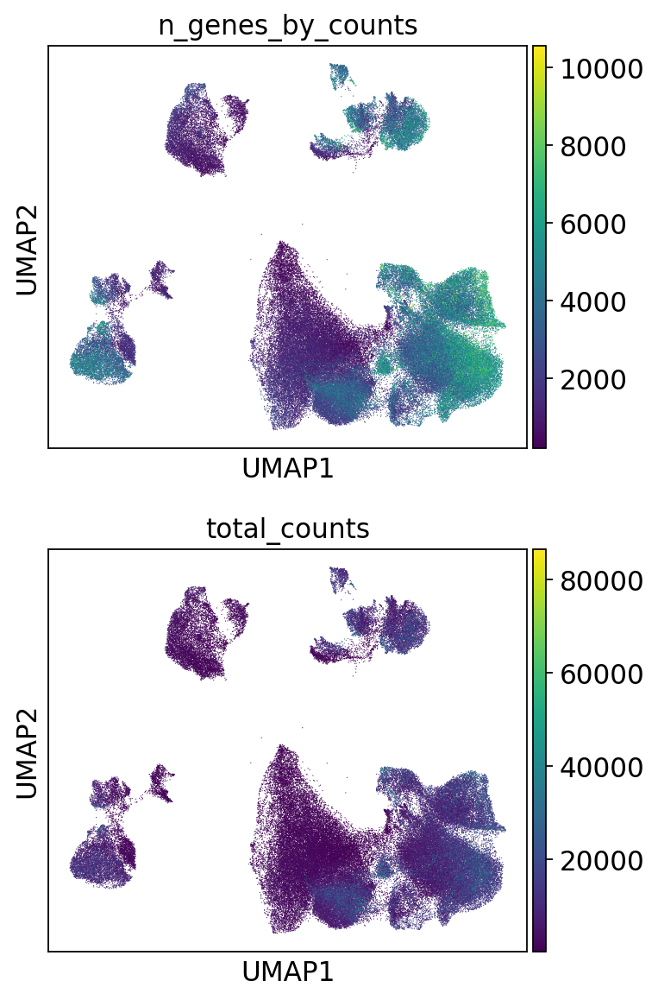

In [72]:
sc.pl.umap(ldata_control, color=["n_genes_by_counts", "total_counts"], ncols=1)

In [74]:
#sc.pl.umap(ldata_control, color=["log1p_n_genes_by_counts","log1p_total_counts"], ncols=1)

In [75]:
#Read the marker file:
de_df= pd.read_csv("Placenta_atlas_scVI_vae_DE_Bayes_310122.csv", index_col=0)

de_df.head()

,proba_de,proba_not_de,bayes_factor,scale1,scale2,lfc_mean,lfc_median,lfc_std,lfc_min,lfc_max,raw_mean1,raw_mean2,non_zeros_proportion1,non_zeros_proportion2,raw_normalized_mean1,raw_normalized_mean2,comparison
TMEM156,0.9988,0.0012,6.724225,0.000676,0.000017,6.524147,6.481064,2.506386,-1.932474,16.005856,0.558442,0.006596,0.337662,0.005905,13.620247,0.094511,vBcell vs Rest
TRBC2,0.9988,0.0012,6.724225,0.000108,0.000007,5.269394,5.302213,1.789270,-4.192872,12.326523,0.032468,0.002289,0.032468,0.002111,0.985725,0.056671,vBcell vs Rest
PAX5,0.9986,0.0014,6.569875,0.001059,0.000005,7.848294,8.042557,2.663970,-1.118943,15.497923,0.896104,0.001490,0.525974,0.001476,24.662205,0.018279,vBcell vs Rest
TRAT1,0.9984,0.0016,6.436144,0.000104,0.000005,5.819153,5.890491,2.089009,-3.443039,12.140464,0.038961,0.001469,0.038961,0.001412,1.350548,0.034425,vBcell vs Rest
IGHM,0.9982,0.0018,6.318161,0.001911,0.000016,7.335082,7.456864,2.704960,-2.656166,17.734852,1.324675,0.004464,0.532468,0.004421,40.820312,0.113205,vBcell vs Rest


In [78]:
markers = {}
cats = ldata_control.obs.celltypist_predicted_labels.cat.categories
for i, c in enumerate(cats):
    cid = "{} vs Rest".format(c)
    cell_type_df = de_df.loc[de_df.comparison == cid]

    cell_type_df = cell_type_df[cell_type_df.lfc_mean > 3]

    cell_type_df = cell_type_df[cell_type_df["bayes_factor"] > 3]
    cell_type_df = cell_type_df[cell_type_df["non_zeros_proportion1"] > 0.1]

    markers[c] = cell_type_df.index.tolist()[:6]


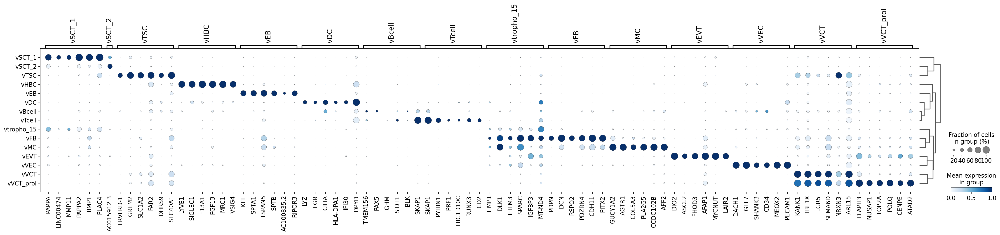

In [77]:
#lfc_mean > 2, "bayes_factor"] > 3 & "non_zeros_proportion1"] > 0.2, 
sc.tl.dendrogram(ldata_control, groupby= "celltypist_predicted_labels", use_rep="X_scVI")

sc.pl.dotplot(ldata_control, markers, groupby='celltypist_predicted_labels', dendrogram=True,
    color_map="Blues", use_raw=True, standard_scale="var")

In [84]:
ldata_no_mt= ldata_control.copy()

#Remove all the MT genes: 
ldata_no_mt = ldata_no_mt[:, ~ldata_no_mt.var_names.str.startswith("MT-")]

In [92]:
markers = {}
cats = ldata_no_mt.obs.celltypist_predicted_labels.cat.categories
for i, c in enumerate(cats):
    cid = "{} vs Rest".format(c)
    cell_type_df = de_df.loc[de_df.comparison == cid]

    cell_type_df = cell_type_df[cell_type_df.lfc_mean > 2.5]

    cell_type_df = cell_type_df[cell_type_df["bayes_factor"] > 3]
    cell_type_df = cell_type_df[cell_type_df["non_zeros_proportion1"] > 0.3]

    markers[c] = cell_type_df.index.tolist()[:6]

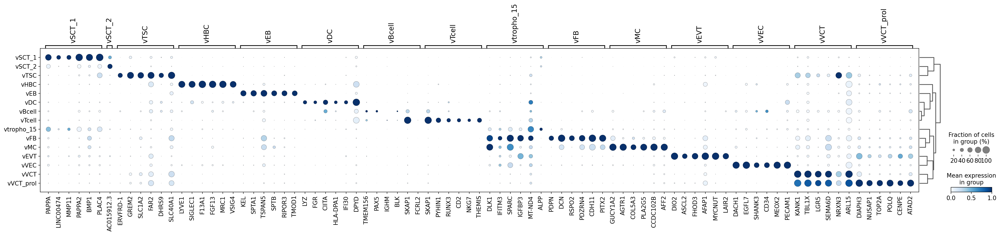

In [93]:
sc.pl.dotplot(ldata_no_mt, markers, groupby='celltypist_predicted_labels', dendrogram=True,
    color_map="Blues", use_raw=True, standard_scale="var")

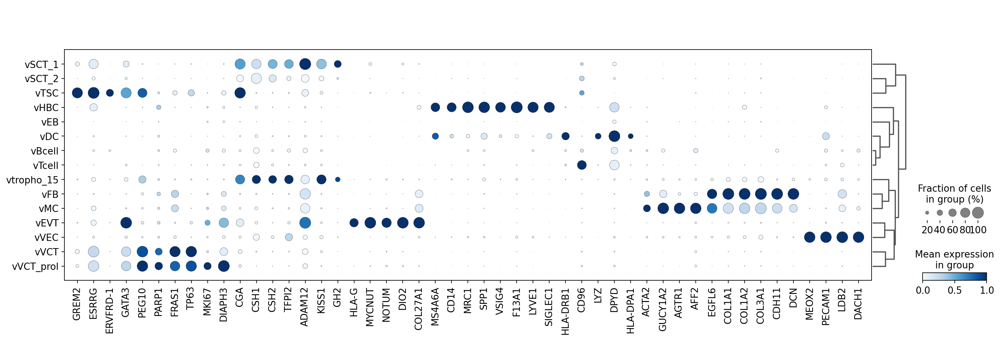

In [94]:
cell_markers= ['GREM2', 'ESRRG', 'ERVFRD-1', 'GATA3', 'PEG10', 'PARP1', 'FRAS1', 'TP63', 'MKI67', 'DIAPH3', 
              'CGA', 'CSH1', 'CSH2', 'TFPI2', 'ADAM12', 'KISS1', 'GH2', 'HLA-G', 'MYCNUT', 'NOTUM', 'DIO2',
              'COL27A1', 'MS4A6A', 'CD14', 'MRC1', 'SPP1', 'VSIG4', 'F13A1', 'LYVE1', 'SIGLEC1', 'HLA-DRB1',
               'CD96', 'LYZ', 'DPYD', 'HLA-DPA1', 'ACTA2', 'GUCY1A2', 'AGTR1', 'AFF2', 'EGFL6', 'COL1A1',
              'COL1A2', 'COL3A1', 'CDH11', 'DCN', 'MEOX2', 'PECAM1', 'LDB2', 'DACH1']

sc.pl.dotplot(ldata_control, cell_markers, groupby='celltypist_predicted_labels', dendrogram=True,
    color_map="Blues", use_raw=True, standard_scale="var")

In [97]:
#Subset the FB clusters (10/27), MC (18) & VEC (22):
adata_fb= ldata_control[ldata_control.obs['leiden'].isin(['10', '27', '18', '22'])]

adata_fb.obs['leiden'].value_counts()

10    5335
18    1881
22    1405
27     669
Name: leiden, dtype: int64

In [98]:
ldata_fb_norm= adata_fb.raw.to_adata()

#Normalize:
sc.pp.normalize_total(ldata_fb_norm, target_sum=10e4)
sc.pp.log1p(ldata_fb_norm)

In [107]:
fb_phenotype= ['CNTN5', 'MEG8', 'COL3A1', 'PDZRN3', 'SLIT2', 'SOX5', 'CHSY3', 'LSAMP',
              'POSTN', 'FBXL7', 'SLIT3', 'DLGAP1', 'COL1A1', 'LINC01266', 'DKK2', 'COL1A2',
              'ST6GALNAC3', 'ROBO2', 'PALLD', 'IL6ST', 'BMP5', 'AC011287.1', 'MAGI2', 'VCAN', 'LINGO2',
              'COL1A1', 'COL4A1', 'COL4A2']


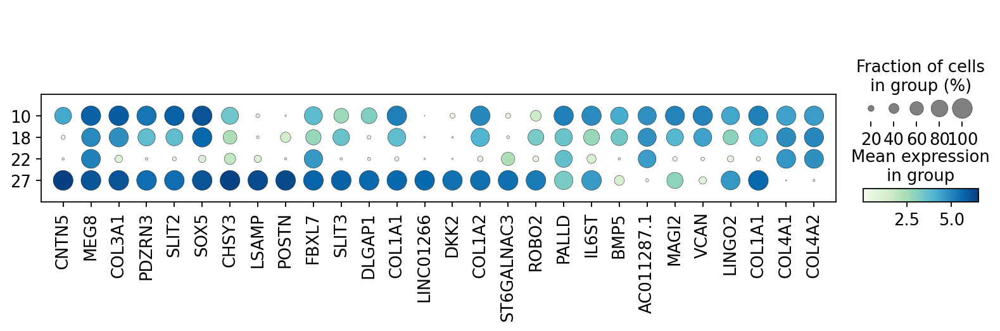

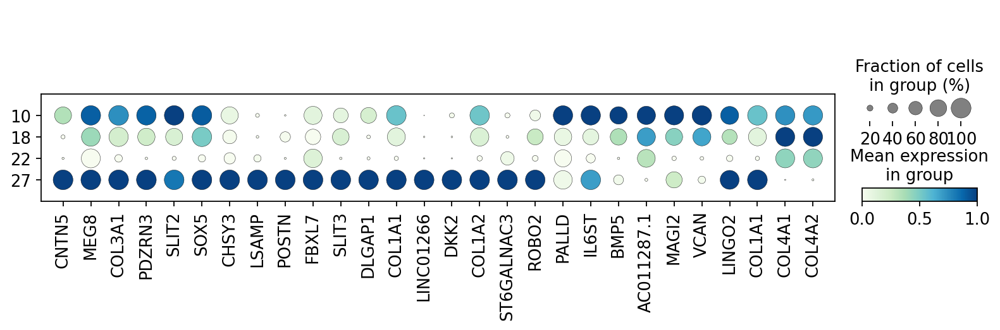

In [108]:
dp_norm = sc.pl.dotplot(ldata_fb_norm, fb_phenotype, 'leiden',  
                       cmap= "GnBu") #use_raw=True, standard_scale="var",

dp_raw = sc.pl.dotplot(adata_fb, fb_phenotype, 'leiden', use_raw=True, standard_scale="var",
                       cmap= "GnBu") #use_raw=True, standard_scale="var",

In [109]:
#Subset the EB clusters (10/27), MC (18) & VEC (22):
adata_eb= ldata_control[ldata_control.obs['leiden'].isin(['17', '11', '26'])]

adata_eb.obs['leiden'].value_counts()

11    5303
17    2149
26     930
Name: leiden, dtype: int64

In [110]:
ldata_eb_norm= adata_eb.raw.to_adata()

#Normalize:
sc.pp.normalize_total(ldata_eb_norm, target_sum=10e4)
sc.pp.log1p(ldata_eb_norm)

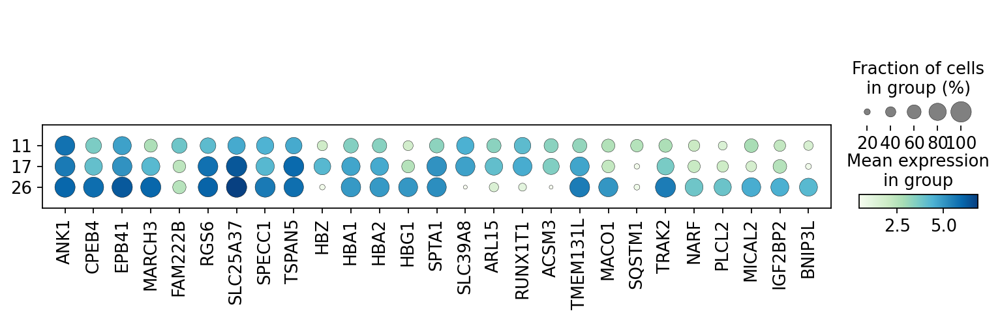

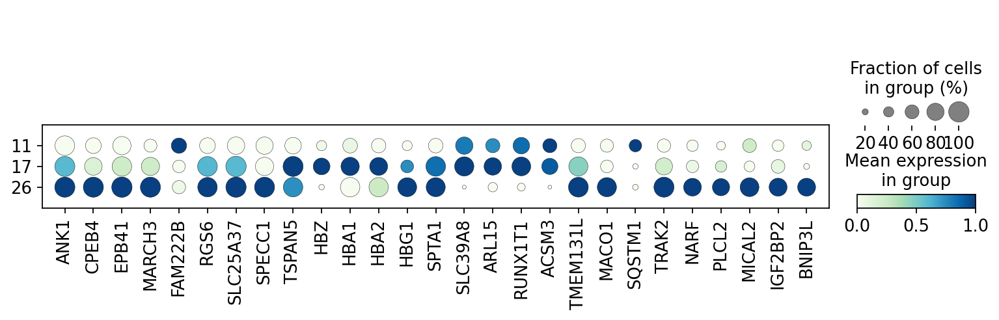

In [112]:
eb_phenotype= ['ANK1', 'CPEB4', 'EPB41', 'MARCH3', 'FAM222B', 'RGS6', 'SLC25A37', 'SPECC1', 'TSPAN5',
              'HBZ', 'HBA1', 'HBA2', 'HBG1', 'SPTA1', 'SLC39A8', 'ARL15', 'RUNX1T1', 'ACSM3', 'TMEM131L',
              'MACO1', 'SQSTM1', 'TRAK2', 'NARF', 'PLCL2', 'MICAL2', 'IGF2BP2', 'BNIP3L']

#Normalized: 
dp_norm = sc.pl.dotplot(ldata_eb_norm, eb_phenotype, 'leiden',  
                       cmap= "GnBu") #use_raw=True, standard_scale="var",


#Raw & scaled: 
dp_raw = sc.pl.dotplot(adata_eb, eb_phenotype, 'leiden', use_raw=True, standard_scale="var",
                       cmap= "GnBu") #use_raw=True, standard_scale="var",

In [114]:
pd.crosstab(ldata_control.obs['celltypist_predicted_labels'], ldata_control.obs['time'])

time,early,late_term
celltypist_predicted_labels,,
vBcell,6,4
vDC,1290,382
vEB,8089,37
vEVT,2528,2
vFB,5756,310
vHBC,5416,1504
vMC,1523,275
vSCT_1,16985,21440
vSCT_2,419,2914


early
late_term


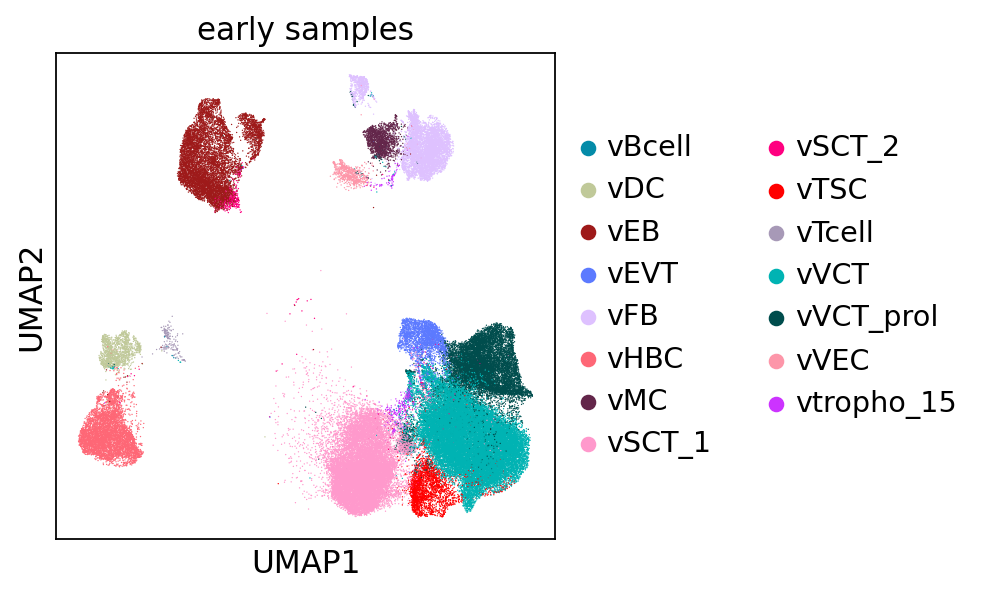

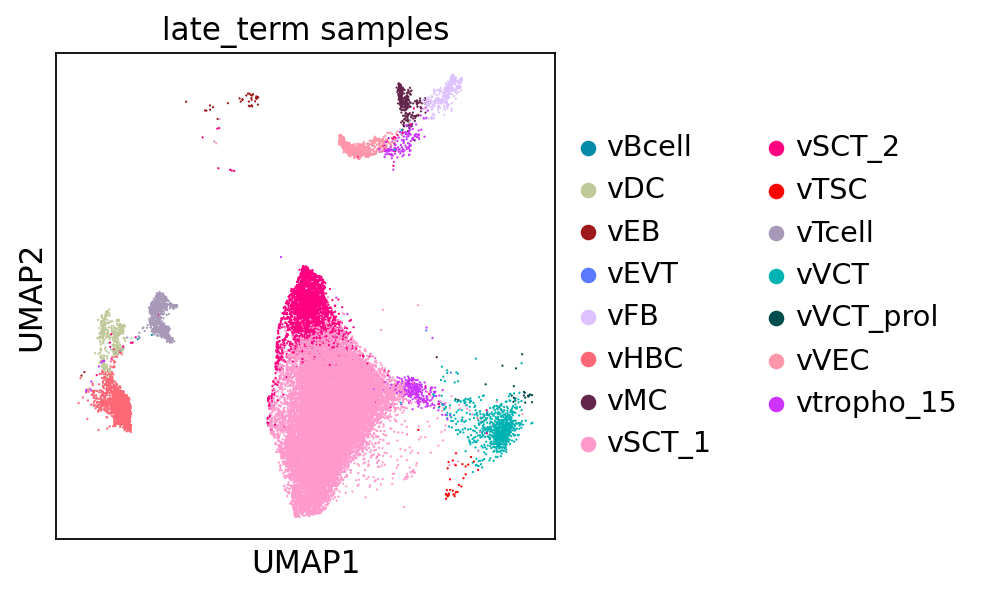

In [115]:
for i in ldata_control.obs['time'].cat.categories:
    print(i) 
    fig= sc.pl.umap(ldata_control[ldata_control.obs['time'] == i], color = 'celltypist_predicted_labels', return_fig=True, title= i+' samples')
    #pdf.savefig(fig)

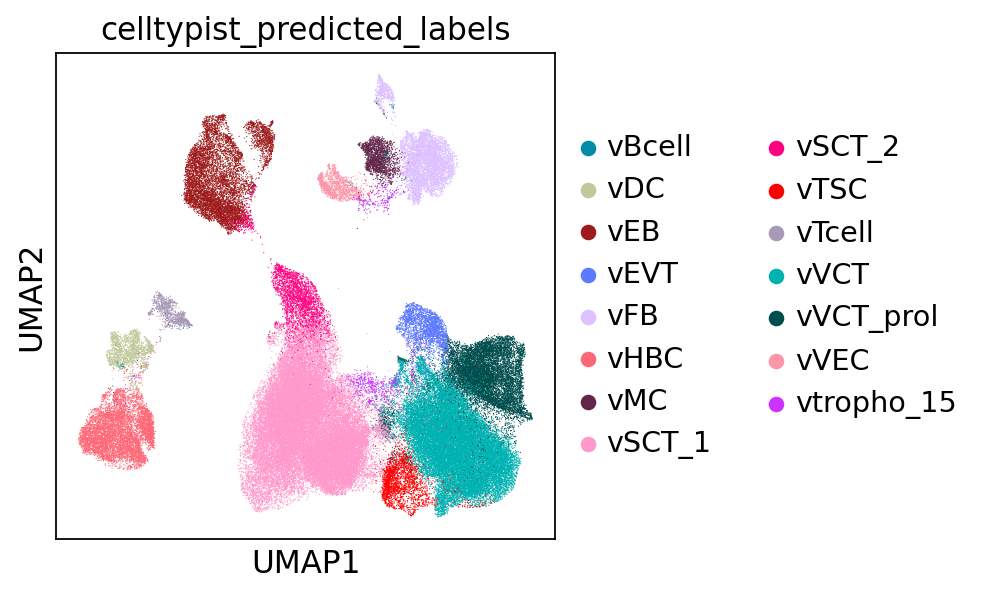

In [121]:
ldata_ctrl_umap= ldata_control.copy()

sc.tl.umap(ldata_ctrl_umap, random_state=0, maxiter=500)
sc.pl.umap(ldata_ctrl_umap, color = 'celltypist_predicted_labels') 

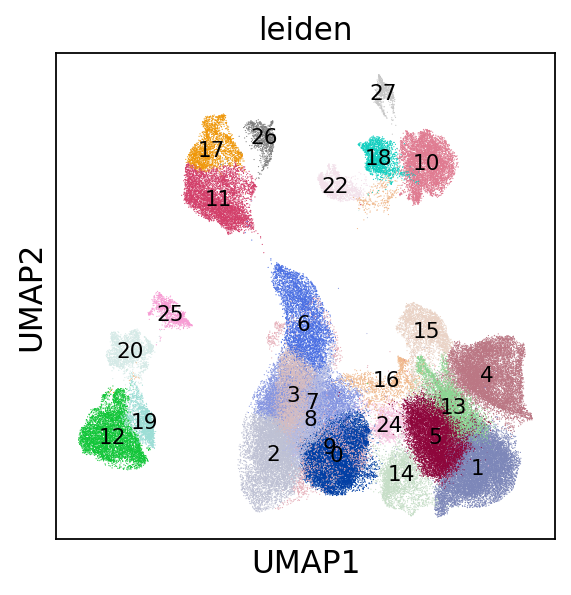

In [123]:
sc.pl.umap(ldata_ctrl_umap, color = 'leiden', legend_loc= "on data", 
          legend_fontweight= 'normal', legend_fontsize= 'x-small') 

In [126]:
#ldata_ctrl_umap= ldata_control.copy()
#sc.tl.umap(ldata_ctrl_umap, random_state=0, maxiter=500)

#Normalize: 
ldata_norm_int= ldata_control.raw.to_adata()
sc.pp.normalize_total(ldata_norm_int, target_sum=10e4)
sc.pp.log1p(ldata_norm_int)

ldata_norm_int.obsm['X_umap']= ldata_ctrl_umap.obsm['X_umap'] #just copy the UMAP coord from maxiter=500. 

#sc.pl.umap(ldata_norm_int, color = ['PEG10', 'TP63', 'YAP1', 'FRAS1', 
                                     #'KISS1', 'PAPPA2', 'CSH1', 'CSH2', 'TFPI2']) 

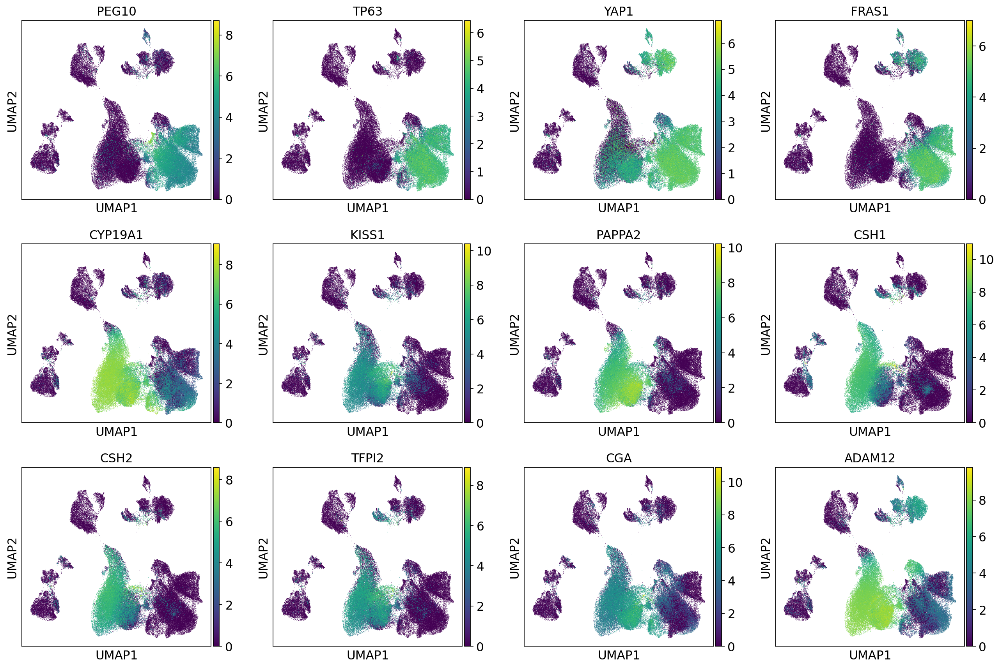

In [127]:
sc.pl.umap(ldata_norm_int, color = ['PEG10', 'TP63', 'YAP1', 'FRAS1', 'CYP19A1', 
                                     'KISS1', 'PAPPA2', 'CSH1', 'CSH2', 'TFPI2','CGA', 'ADAM12']) 

In [132]:
#Barplots for each patient:
#Split sample composition by donor_id:

def make_bar_plots(adata, anno_groupby = 'time',
                         anno_subsets = 'celltypist_predicted_labels',
                         anno_pointdef = 'donor_id',
                         save_file = 'Cell_comp_ctrls_0402_v1.pdf'):
    
    ## Get number of categories
    labels = adata.obs[anno_groupby].cat.categories.tolist()
    n_labels = len(labels)
    subset_ids = adata.obs[anno_subsets].cat.categories.tolist()
    n_subsets = len(subset_ids)
    patient_ids = adata.obs[anno_pointdef].unique()
    n_patients = len(patient_ids)

    ## Calculate subset fractions
    subset_frac = pd.DataFrame(np.empty([n_patients, n_subsets]),
                                    index = patient_ids ,
                                    columns = subset_ids)
    for i in np.arange(n_patients):
        ind2 = adata.obs[anno_pointdef] == patient_ids[i]
        for j in np.arange(n_subsets):
            ind1 = adata.obs[anno_subsets] == subset_ids[j]
            subset_frac.iloc[i,j] = sum(ind1&ind2)
    subset_frac = subset_frac.apply(lambda x: x/sum(x),axis=1)

    ## Get patient labels
    patient_phenos = pd.DataFrame(index = subset_frac.index, columns=[anno_groupby])
    for i in range(0,len(labels)):
        p_list = adata.obs[anno_pointdef][adata.obs[anno_groupby] == labels[i]].unique().tolist()
        patient_phenos[anno_groupby][p_list] = labels[i]
    patient_phenos['time'] = patient_phenos['time'].astype('category')
    patient_phenos['time'] = patient_phenos['time'].cat.reorder_categories(labels)
    ord_ind = patient_phenos.sort_values('time', ascending=False).index

    subset_frac = subset_frac.loc[ord_ind]

    fig, axes = plt.subplots(1,1, figsize=(9,12))

    subset_frac.plot.barh(stacked=True, grid=False, legend=False, ax=axes, color= ["#048bA8", "#c0c999", "#9e1a1a", "#5c7aff", "#dec1ff", 
                                                 "#fe6776", "#63264a", "#ff99cc", "#ff0080", "#ff0000", 
                                                 "#a799b7", "#00b3b3", "#004d4d", "#fd96A9", "#cc33ff"])
    # Shrink current axis by 20%
    box = axes.get_position()
    axes.set_position([box.x0, box.y0, box.width * 0.8, box.height])

    axes.legend(loc='lower right', bbox_to_anchor=(1.5, 0.5), frameon=True)
    sns.despine(left=True, bottom=True, right=True)
    plt.tight_layout()
    plt.savefig(save_file)

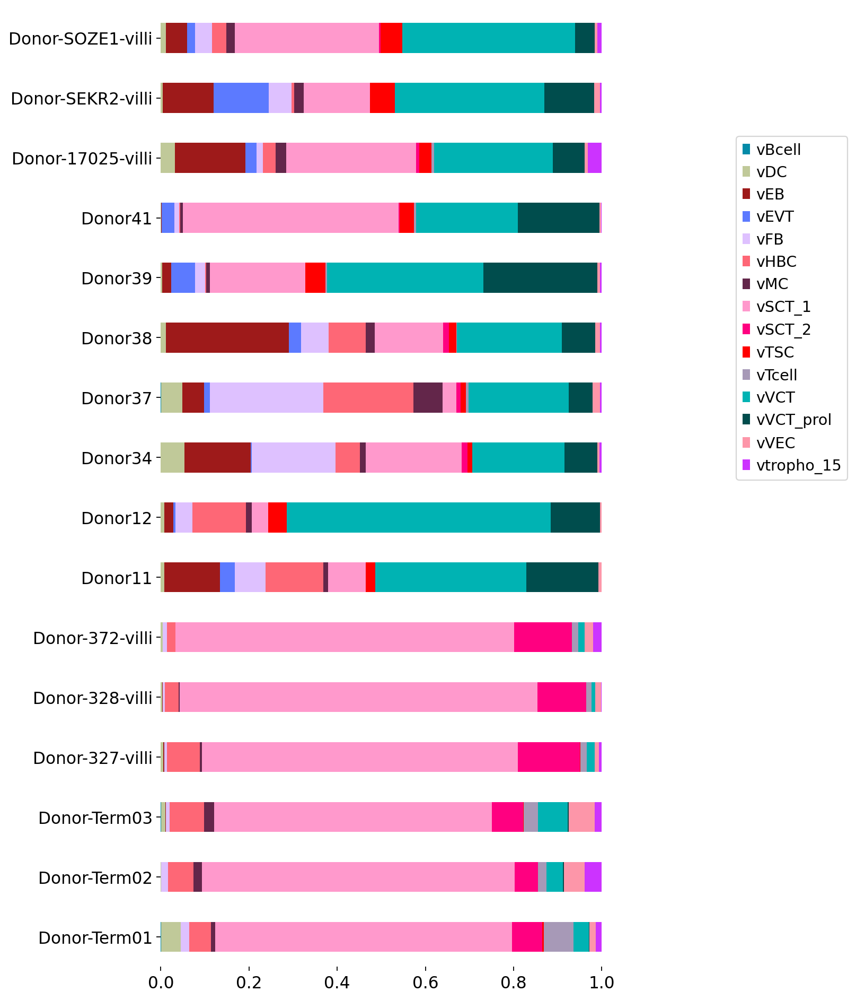

In [133]:
import seaborn as sns

make_bar_plots(ldata_control) #After exclusing D13 & D16. 

In [134]:
ldata_control.raw.X #check the dimension of raw data

<111787x29148 sparse matrix of type '<class 'numpy.float32'>'
	with 269380856 stored elements in Compressed Sparse Row format>

In [135]:
!mkdir placenta_control_processed

In [137]:
ldata_control

AnnData object with n_obs × n_vars = 111787 × 3000
    obs: 'batch', 'cohort', 'disease', 'donor_id', 'gestational_days', 'gestational_weeks', 'library', 'maternal_BMI', 'maternal_age', 'placental_volume', 'procurement', 'smoking', 'time', 'tissue', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_MT_genes', 'log1p_total_counts_MT_genes', 'pct_counts_MT_genes', 'total_counts_Ribo_genes', 'log1p_total_counts_Ribo_genes', 'pct_counts_Ribo_genes', 'total_counts_HB_genes', 'log1p_total_counts_HB_genes', 'pct_counts_HB_genes', 'percent_mt2', 'n_counts', 'percent_Ribo2', 'percent_HB2', 'n_genes', 'XIST-counts', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden', 'celltypist_majority_voting', 'celltypist_predicted_labels', 'LDA_topic_0', 'LDA_topic_1', 'LDA_topic_2', 'LDA_topic_3', 'LDA_topic_4', 'LDA_topic_5', 'LDA_topic_6', 'LDA_topic_7', 'LDA_topic_8', 'LDA_topic_9', 'LDA_top

In [ ]:
results_control= "./placenta_control_processed/Controls_placenta_scvi_040222.h5ad"

ldata_control.write(results_control)